In [108]:
import os
import rasterio as rio
import numpy as np
import shapely
import pyproj
import geopandas as gpd
import matplotlib.pyplot as plt
import rioxarray as riox
import rasterio as rio
import xarray as xr
import netCDF4
from osgeo import gdal
import pandas as pd
from datetime import datetime
import snowFun
import importlib
importlib.reload(snowFun)
import dask.array
from matplotlib.colors import TwoSlopeNorm
from matplotlib.colors import LogNorm
# %matplotlib widget

# define folder and file paths
folder_AGVA = os.path.join('C:',os.sep,'Users','lzell','OneDrive - Colostate','Desktop',"AGVA")
folder_dems = os.path.join(folder_AGVA, "DEMs", "time_varying_DEMs", "10m")
folder_class = os.path.join(folder_AGVA, 'classified images', 'S2_Classified_Cloudmasked_Merged')
folder_cloud = os.path.join(folder_AGVA, 'classified images', 'S2_Cloud_Merged')
folder_meta = os.path.join(folder_AGVA, "classified images", "meta csv", "S2")
folder_climate = os.path.join(folder_AGVA, "Climate")

# open rgi
path_rgi = os.path.join(folder_AGVA, 'RGI', "rgi_2km_o3regions", "rgi_2km_o3regions.shp")
rgi_gdf = gpd.read_file(path_rgi, include_fields=['RGIId', 'geometry'])

# open the big data csv
path_data = os.path.join(folder_AGVA, 'Derived products', 'S2', 'Final_Data_Table.csv')
data_df = pd.read_csv(path_data)

# open monthly climate csv
path_climate = os.path.join(folder_climate, 'RGI_Monthly_Averages.csv')
climate_df = pd.read_csv(path_climate)

# subset rgi to the glaciers we have data for
rgi_gdf = rgi_gdf[ rgi_gdf['RGIId'].isin(data_df['RGIId']) ]
# print(rgi_gdf.columns)

# merge columns
all_data_gdf = gpd.GeoDataFrame(pd.merge(data_df, rgi_gdf, on="RGIId"))

# replace -9999 with nan
all_data_gdf[all_data_gdf==-9999] = np.nan

### add climate as columns
all_data_gdf = gpd.GeoDataFrame(pd.merge(all_data_gdf, climate_df, on="RGIId"))

# what columns are available?
print(all_data_gdf.shape)
print(all_data_gdf.columns.values)

(3023, 233)
['RGIId' 'GLIMSId' 'BgnDate' 'EndDate' 'CenLon' 'CenLat' 'O1Region'
 'O2Region' 'Area' 'Zmin' 'Zmax' 'Zmed' 'Slope' 'Aspect' 'Lmax' 'Status'
 'Connect' 'Form' 'TermType' 'Surging' 'Linkages' 'Name' 'O3Region'
 'O3_name' 'ela_2018' 'ela_2019' 'ela_2020' 'ela_2021' 'ela_2022'
 'aar_2018' 'aar_2019' 'aar_2020' 'aar_2021' 'aar_2022' 'off_glacier_2018'
 'off_glacier_2019' 'off_glacier_2020' 'off_glacier_2021'
 'off_glacier_2022' 'date_2018' 'date_2019' 'date_2020' 'date_2021'
 'date_2022' 'ela_avg_product' 'aar_avg_product' 'off_glacier_avg_product'
 'percent_observed_average_product' 'dhdt_1520' 'dhdt_1020'
 'distance_from_ocean' 'geometry' 'z_era5land' '18_01_p' '18_01_t'
 '18_01_pdd' '18_02_p' '18_02_t' '18_02_pdd' '18_03_p' '18_03_t'
 '18_03_pdd' '18_04_p' '18_04_t' '18_04_pdd' '18_05_p' '18_05_t'
 '18_05_pdd' '18_06_p' '18_06_t' '18_06_pdd' '18_07_p' '18_07_t'
 '18_07_pdd' '18_08_p' '18_08_t' '18_08_pdd' '18_09_p' '18_09_t'
 '18_09_pdd' '18_10_p' '18_10_t' '18_10_pdd' '18_1

# Calculate additional column data

### Average AAR, ELA, AA, and anomalies for each year

In [109]:
all_data_gdf['aar_median'] = all_data_gdf[['aar_2018', 'aar_2019', 'aar_2020', 'aar_2021', 'aar_2022']].median(axis=1, skipna=True)
all_data_gdf['ela_median'] = all_data_gdf[['ela_2018', 'ela_2019', 'ela_2020', 'ela_2021', 'ela_2022']].median(axis=1, skipna=True)
all_data_gdf['aa_median'] = all_data_gdf['aar_median']*all_data_gdf['Area']

for y in [2018,2019,2020,2021,2022]:
    all_data_gdf[f'aa_{y}'] = all_data_gdf[f'aar_{y}']*all_data_gdf['Area']
    all_data_gdf[f'aar_{y}_relative'] = all_data_gdf[f'aar_{y}'] - all_data_gdf[f'aar_median']
    all_data_gdf[f'ela_{y}_relative'] = all_data_gdf[f'ela_{y}'] - all_data_gdf[f'ela_median']

# min and max ela, aar
all_data_gdf['aar_min'] = all_data_gdf[['aar_2018', 'aar_2019', 'aar_2020', 'aar_2021', 'aar_2022']].min(axis=1, skipna=True)
all_data_gdf['aar_max'] = all_data_gdf[['aar_2018', 'aar_2019', 'aar_2020', 'aar_2021', 'aar_2022']].max(axis=1, skipna=True)
all_data_gdf['ela_min'] = all_data_gdf[['ela_2018', 'ela_2019', 'ela_2020', 'ela_2021', 'ela_2022']].min(axis=1, skipna=True)
all_data_gdf['ela_max'] = all_data_gdf[['ela_2018', 'ela_2019', 'ela_2020', 'ela_2021', 'ela_2022']].max(axis=1, skipna=True)
all_data_gdf['aar_range']= all_data_gdf['aar_max'] - all_data_gdf['aar_min']
all_data_gdf['ela_range']= all_data_gdf['ela_max'] - all_data_gdf['ela_min']
all_data_gdf['ela_range_norm']= all_data_gdf['ela_range']/(all_data_gdf['Zmax']-all_data_gdf['Zmin'])

### Count number of years with ELA off-glacier, and years with essentially no AA

In [110]:
### count number of years with ela off-glacier
# first need to fix the column
for y in [2018,2019,2020,2021,2022]:
    all_data_gdf[f'off_glacier_{y}'].replace({"False":"0", "True":"1"}, inplace=True)
    all_data_gdf[f'off_glacier_{y}'] = all_data_gdf[f'off_glacier_{y}'].astype(int)
    all_data_gdf[f'off_glacier_{y}'].replace(-9999, np.nan, inplace=True)
all_data_gdf["off_glacier_total"] = all_data_gdf[['off_glacier_2018', 'off_glacier_2019', 'off_glacier_2020', 'off_glacier_2021', 'off_glacier_2022']].sum(axis=1, skipna=True)

### count number of years with aar<0.1
all_data_gdf["no_aar_total"] = (all_data_gdf[['aar_2018', 'aar_2019', 'aar_2020', 'aar_2021', 'aar_2022']]<0.1).sum(axis=1, skipna=True)

In [111]:
### count number of years with at least one or the other
ns = np.zeros(len(all_data_gdf))
for y in [2018,2019,2020,2021,2022]:
    ns += ((all_data_gdf[f'off_glacier_{y}']==1) | (all_data_gdf[f'aar_{y}']<0.1))
all_data_gdf["no_aar_or_no_ela"] = ns

### Get the day of year of each observation, doy anomaly

In [112]:
for y in [2018,2019,2020,2021,2022]:
    all_data_gdf[f'doy_{y}'] = pd.to_datetime(all_data_gdf[f'date_{y}']).dt.dayofyear.replace(1, np.nan)

all_data_gdf['doy_median'] = all_data_gdf[['doy_2018', 'doy_2019', 'doy_2020', 'doy_2021', 'doy_2022']].median(axis=1, skipna=True)

for y in [2018,2019,2020,2021,2022]:
    all_data_gdf[f'doy_{y}_anom'] = all_data_gdf[f'doy_{y}'] - all_data_gdf['doy_median']

### Summer and winter temperature, precipitation averages and anomalies

In [113]:
### calculate some climate parameters here

# define winter and summer months
all_years = ['18','19','20','21','22']
months_summer = ['06','07','08','09']
months_winter = ['01','02','03','04']

columns_s = [f'{y}_{m}' for m in months_summer for y in all_years]
columns_w = [f'{y}_{m}' for m in months_winter for y in all_years]

# calculate average temp and precip for summer and winter
all_data_gdf['t_s_avg'] =  all_data_gdf[[f'{m}_t' for m in columns_s]].mean(axis=1, skipna=True)
all_data_gdf['t_w_avg'] =  all_data_gdf[[f'{m}_t' for m in columns_w]].mean(axis=1, skipna=True)
all_data_gdf['p_s_avg'] =  all_data_gdf[[f'{m}_p' for m in columns_s]].mean(axis=1, skipna=True)
all_data_gdf['p_w_avg'] =  all_data_gdf[[f'{m}_p' for m in columns_w]].mean(axis=1, skipna=True)

# calculate annual anomalies for each year/season
for y in all_years:
    
    # temperatures
    all_data_gdf[f't_s_{y}_anom'] = all_data_gdf[[f'{y}_{m}_t' for m in months_summer]].mean(axis=1, skipna=True) - all_data_gdf['t_s_avg']
    all_data_gdf[f't_w_{y}_anom'] = all_data_gdf[[f'{y}_{m}_t' for m in months_winter]].mean(axis=1, skipna=True) - all_data_gdf['t_w_avg']
    
    # precips
    all_data_gdf[f'p_s_{y}_anom'] = all_data_gdf[[f'{y}_{m}_p' for m in months_summer]].mean(axis=1, skipna=True) - all_data_gdf['p_s_avg']
    all_data_gdf[f'p_w_{y}_anom'] = all_data_gdf[[f'{y}_{m}_p' for m in months_winter]].mean(axis=1, skipna=True) - all_data_gdf['p_w_avg']

    

### Calculate positive degree days for each glacier each year (April to September).
PDDs are calculated for the median glacier elevation (from RGI), using temperature from ERA5-Land at the glacier center point, and assuming a -5.0 degrees C lapse rate

In [114]:
# calculate annual PDDs for each glacier (lets say april to september), anomaly from mean
months_pdd = ['04', '05', '06','07','08','09']

for y in all_years:
    all_data_gdf[f'pdd_{y}'] = all_data_gdf[[f'{y}_{m}_pdd' for m in months_pdd]].sum(axis=1, skipna=True)

all_data_gdf['pdd_avg'] = all_data_gdf[['pdd_18', 'pdd_19', 'pdd_20', 'pdd_21', 'pdd_22']].mean(axis=1, skipna=True)

for y in all_years:
    all_data_gdf[f'pdd_{y}_anom_diff'] = all_data_gdf[f'pdd_{y}'] - all_data_gdf['pdd_avg'] # calculate as difference
    all_data_gdf[f'pdd_{y}_anom_frac'] = all_data_gdf[f'pdd_{y}'] / all_data_gdf['pdd_avg'] # calculate as ratio

### Some examples of how to calculate region-wide values

In [115]:
# add column for the total glacier area in each O2Region
temp = all_data_gdf.groupby('O2Region')['Area'].sum().rename('O2Region_area')
all_data_gdf = gpd.GeoDataFrame(pd.merge(all_data_gdf, temp, on="O2Region"))

# add column for the total glacier area in each O3Region
temp = all_data_gdf.groupby('O3Region')['Area'].sum().rename('O3Region_area')
all_data_gdf = gpd.GeoDataFrame(pd.merge(all_data_gdf, temp, on="O3Region"))

# add column for the AAR in each O3Region
temp = all_data_gdf.groupby('O3Region')['aa_median'].sum().rename('O3Region_aa')
all_data_gdf = gpd.GeoDataFrame(pd.merge(all_data_gdf, temp, on="O3Region"))
all_data_gdf['O3Region_aar'] = all_data_gdf['O3Region_aa'] / all_data_gdf['O3Region_area']
# all_data_gdf.columns.values

In [116]:
# calculate region-wide area-averaged dhdt
all_data_gdf['temp'] = (all_data_gdf['Area']/all_data_gdf['O3Region_area']) * all_data_gdf['dhdt_1520']
temp = all_data_gdf.groupby('O3Region')['temp'].sum().rename('O3Region_dhdt_1520')
all_data_gdf = gpd.GeoDataFrame(pd.merge(all_data_gdf, temp, on="O3Region"))

# lets make a whole new df for o3region stats

In [83]:
# start by getting the full geometry for each subregion. keep this stored in a separate gdf for later
O3_geom = all_data_gdf[['geometry', 'O3Region']].dissolve(by='O3Region').reset_index()

In [84]:
# create pandas df (no geometry)
# calculating total glacier number, glacier area, mean and median size, aa, and aar for each region
o3_df = pd.DataFrame(all_data_gdf.groupby('O3Region')['Area'].count().rename('number'))
o3_df['area'] = all_data_gdf.groupby('O3Region')['Area'].sum()
o3_df['area_mean'] = all_data_gdf.groupby('O3Region')['Area'].mean()
o3_df['area_median'] = all_data_gdf.groupby('O3Region')['Area'].median()
o3_df['aa'] = all_data_gdf.groupby('O3Region')['aa_median'].sum()
o3_df['aar'] = o3_df['aa']/o3_df['area']

# calculate dhdt for each region
all_data_gdf['temporary'] = (all_data_gdf['Area']/all_data_gdf['O3Region_area']) * all_data_gdf['dhdt_1520']
o3_df['dhdt_1520'] = all_data_gdf.groupby('O3Region')['temporary'].sum()
all_data_gdf['temporary'] = (all_data_gdf['Area']/all_data_gdf['O3Region_area']) * all_data_gdf['dhdt_1020']
o3_df['dhdt_1020'] = all_data_gdf.groupby('O3Region')['temporary'].sum()

# calculate aar each year
for y in [2018,2019,2020,2021,2022]:
    o3_df[f'aa_{y}'] = all_data_gdf.groupby('O3Region')[f'aa_{y}'].sum()
    o3_df[f'aar_{y}'] = o3_df[f'aa_{y}']/o3_df['area']

# calculate average elas each year, for glaciers where ela was observed
for y in [2018,2019,2020,2021,2022]:
    
    # for this year, subset to valid ela obs
    temp = all_data_gdf[all_data_gdf[f'off_glacier_{y}']==0]
    o3_df[f'ela_mean_{y}'] = temp.groupby('O3Region')[f'ela_{y}'].mean()
    o3_df[f'ela_median_{y}'] = temp.groupby('O3Region')[f'ela_{y}'].median()
    
    # do the same, but only for larger glaciers (5km2 or bigger)
    temp = all_data_gdf[ (all_data_gdf[f'off_glacier_{y}']==0) & (all_data_gdf['Area']>=5) ]
    o3_df[f'ela_5km_mean_{y}'] = temp.groupby('O3Region')[f'ela_{y}'].mean()
    o3_df[f'ela_5km_median_{y}'] = temp.groupby('O3Region')[f'ela_{y}'].median()

# get 5-year average ela
o3_df[f'ela_mean'] = o3_df[['ela_mean_2018','ela_mean_2019','ela_mean_2020','ela_mean_2021','ela_mean_2022']].mean(axis=1)
o3_df[f'ela_median'] = o3_df[['ela_median_2018','ela_median_2019','ela_median_2020','ela_median_2021','ela_median_2022']].mean(axis=1)
o3_df[f'ela_5km_mean'] = o3_df[['ela_5km_mean_2018','ela_5km_mean_2019','ela_5km_mean_2020','ela_5km_mean_2021','ela_5km_mean_2022']].mean(axis=1)
o3_df[f'ela_5km_median'] = o3_df[['ela_5km_median_2018','ela_5km_median_2019','ela_5km_median_2020','ela_5km_median_2021','ela_5km_median_2022']].mean(axis=1)


# get ela, aar anomaly each year
for y in [2018,2019,2020,2021,2022]:
    o3_df[f'ela_anom_{y}'] = o3_df[f'ela_median_{y}'] - o3_df[f'ela_median']
    o3_df[f'ela_5km_anom_{y}'] = o3_df[f'ela_5km_median_{y}'] - o3_df[f'ela_5km_median']
    o3_df[f'aar_anom_{y}'] = o3_df[f'aar_{y}'] - o3_df['aar']

# add geometry in at the end
o3_df = gpd.GeoDataFrame(pd.merge(o3_df, O3_geom, on="O3Region"))

# remove the glaciers in O3Region=0 (these are glaciers that don't fit into any of the regions)
o3_df = o3_df.drop(0, axis=0)
o3_df.head()

,O3Region,number,area,area_mean,area_median,aa,aar,dhdt_1520,dhdt_1020,aa_2018,...,ela_anom_2020,ela_5km_anom_2020,aar_anom_2020,ela_anom_2021,ela_5km_anom_2021,aar_anom_2021,ela_anom_2022,ela_5km_anom_2022,aar_anom_2022,geometry
1,1,176,1554.897,8.834642,4.4745,372.612028,0.239638,-0.819874,-0.756960,293.790669,...,198.0,96.0,-0.018691,-202.0,-249.0,0.079346,68.0,56.0,0.027766,"MULTIPOLYGON (((-968410.118 453893.876, -96840..."
2,2,214,2362.277,11.038678,3.6620,685.176416,0.290049,-0.970796,-0.900448,809.267843,...,110.0,110.0,-0.049989,-50.0,-75.0,0.069871,-40.0,-15.0,0.015988,"MULTIPOLYGON (((26521.392 1113399.086, 26523.6..."
3,3,95,1710.748,18.007874,3.7640,455.212271,0.266090,-0.794230,-0.728604,490.094077,...,130.0,199.0,-0.029041,-110.0,-141.0,0.022590,-140.0,-181.0,0.008519,"MULTIPOLYGON (((-397.581 1265559.060, -332.771..."
4,4,109,3431.486,31.481523,4.8450,1019.735430,0.297170,-1.039625,-0.967613,976.774487,...,80.0,59.0,-0.052844,-230.0,-276.0,0.060555,-120.0,-91.0,-0.019544,"MULTIPOLYGON (((74208.979 1349765.634, 74221.3..."
5,5,103,2329.985,22.621214,6.4500,593.949220,0.254915,-0.984158,-0.924617,708.404407,...,-105.0,-67.0,0.024530,110.0,83.0,-0.042665,-120.0,-127.0,0.019214,"MULTIPOLYGON (((307520.734 1522040.274, 307533..."


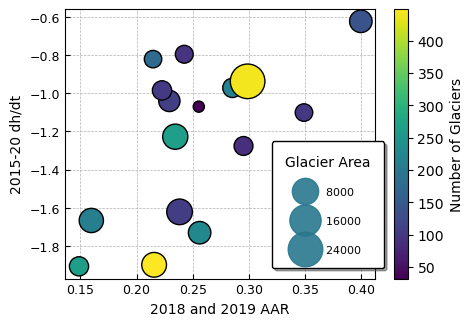

In [85]:
# initial investigation of O3Region stats
fig,axs = plt.subplots(figsize=(5,3.5), dpi=100)

sc = axs.scatter((o3_df['aar_2018']+o3_df['aar_2019'])/2, o3_df['dhdt_1520'], zorder=10,
                    s=4*(o3_df['area']**0.5),
                    c=o3_df['number'],
                    edgecolor='black')

# set tick and label stuff
axs.set_xlabel("2018 and 2019 AAR", fontsize = 10)
axs.set_ylabel("2015-20 dh/dt", fontsize = 10)
axs.tick_params(axis='both', direction='in', labelsize=9)

# add grid
axs.grid(zorder=1, linestyle='dashed', linewidth=0.5)

# format legend for the sizing https://matplotlib.org/stable/gallery/lines_bars_and_markers/scatter_with_legend.html
handles, labels = sc.legend_elements(prop="sizes",
                                     alpha=0.9, num=3, color=sc.cmap(0.4),
                                     func=lambda s: (s/4)**2  )

legend2 = axs.legend(handles, labels, title="Glacier Area",
                     labelspacing=1.5, borderpad=1.2, edgecolor='black', fontsize=8,
                     loc='upper left', bbox_to_anchor=(0.65, 0.53), fancybox=True, shadow=True)

# put colorbar for continuous color scale
plt.colorbar(sc, label='Number of Glaciers')

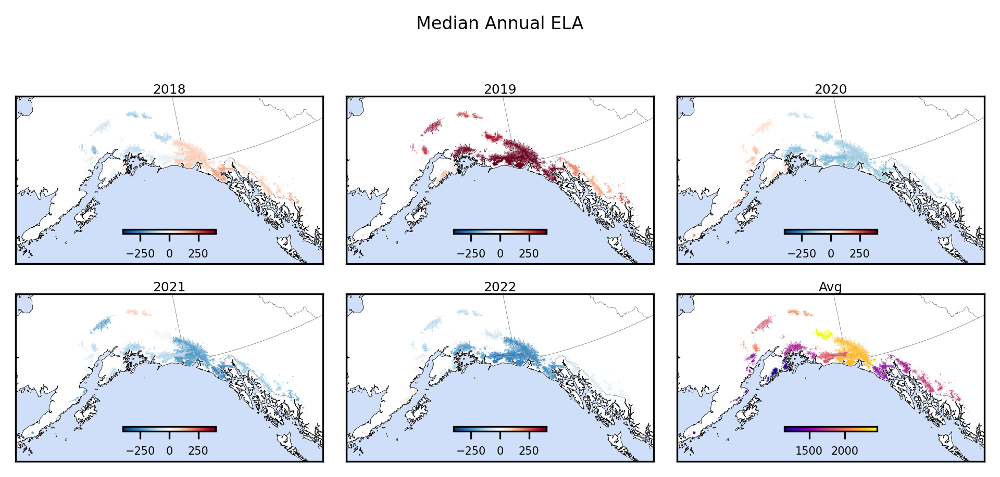

In [286]:
fig,axs = snowFun.create_annual_base_maps(hillshade=0)
ax18,ax19,ax20,ax21,ax22,axav = [a for ax in axs for a in ax] # flatten out everything
all_axs = [ax18,ax19,ax20,ax21,ax22,axav]
vmin=-400
vmax=400
cmap='RdBu_r'

p18 = o3_df.plot(ax=ax18, column='ela_anom_2018', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p19 = o3_df.plot(ax=ax19, column='ela_anom_2019', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p20 = o3_df.plot(ax=ax20, column='ela_anom_2020', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p21 = o3_df.plot(ax=ax21, column='ela_anom_2021', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p22 = o3_df.plot(ax=ax22, column='ela_anom_2022', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

pav = o3_df.plot(ax=axav, column='ela_median', zorder=10, cmap='plasma', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

# format colorbar in each axes
for ax in fig.axes[-6:]:
    ax.tick_params(labelsize=5)
    
plt.figtext(0.5,0.9, "Median Annual ELA", ha='center', size=8)
plt.tight_layout()

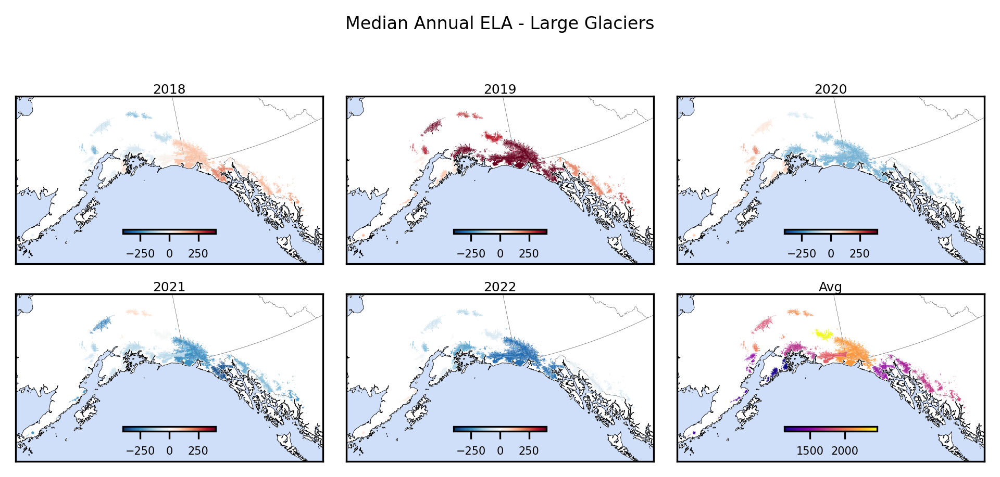

In [295]:
fig,axs = snowFun.create_annual_base_maps(hillshade=0)
ax18,ax19,ax20,ax21,ax22,axav = [a for ax in axs for a in ax] # flatten out everything
all_axs = [ax18,ax19,ax20,ax21,ax22,axav]
vmin=-400
vmax=400
cmap='RdBu_r'

p18 = o3_df.plot(ax=ax18, column='ela_5km_anom_2018', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p19 = o3_df.plot(ax=ax19, column='ela_5km_anom_2019', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p20 = o3_df.plot(ax=ax20, column='ela_5km_anom_2020', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p21 = o3_df.plot(ax=ax21, column='ela_5km_anom_2021', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p22 = o3_df.plot(ax=ax22, column='ela_5km_anom_2022', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

pav = o3_df.plot(ax=axav, column='ela_5km_median', zorder=10, cmap='plasma', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

# format colorbar in each axes
for ax in fig.axes[-6:]:
    ax.tick_params(labelsize=5)
    
plt.figtext(0.5,0.9, "Median Annual ELA - Large Glaciers", ha='center', size=8)
plt.tight_layout()

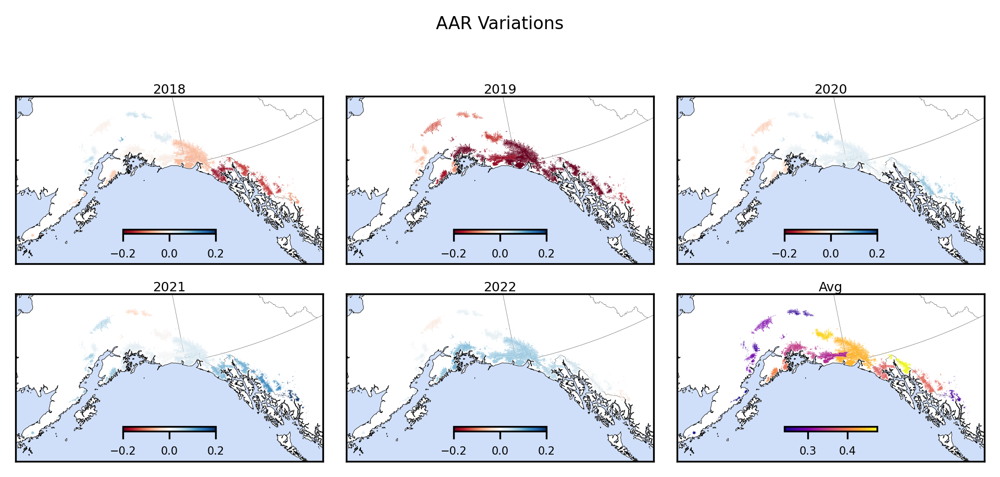

In [290]:
fig,axs = snowFun.create_annual_base_maps(hillshade=0)
ax18,ax19,ax20,ax21,ax22,axav = [a for ax in axs for a in ax] # flatten out everything
all_axs = [ax18,ax19,ax20,ax21,ax22,axav]
vmin=-0.2
vmax=.2
cmap='RdBu'

p18 = o3_df.plot(ax=ax18, column='aar_anom_2018', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p19 = o3_df.plot(ax=ax19, column='aar_anom_2019', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p20 = o3_df.plot(ax=ax20, column='aar_anom_2020', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p21 = o3_df.plot(ax=ax21, column='aar_anom_2021', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p22 = o3_df.plot(ax=ax22, column='aar_anom_2022', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

pav = o3_df.plot(ax=axav, column='aar', zorder=10, cmap='plasma', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

# format colorbar in each axes
for ax in fig.axes[-6:]:
    ax.tick_params(labelsize=5)
    
plt.figtext(0.5,0.9, "AAR Variations", ha='center', size=8)
plt.tight_layout()

# repeat for O2Region stats

In [233]:
# start by getting the full geometry for each subregion. keep this stored in a separate gdf for later
O2_geom = all_data_gdf[['geometry', 'O2Region']].dissolve(by='O2Region').reset_index()

In [240]:
# create pandas df (no geometry)
# calculating total glacier number, glacier area, mean and median size, aa, and aar for each region
o2_df = pd.DataFrame(all_data_gdf.groupby('O2Region')['Area'].count().rename('number'))
o2_df['area'] = all_data_gdf.groupby('O2Region')['Area'].sum()
o2_df['area_mean'] = all_data_gdf.groupby('O2Region')['Area'].mean()
o2_df['area_median'] = all_data_gdf.groupby('O2Region')['Area'].median()
o2_df['aa'] = all_data_gdf.groupby('O2Region')['aa_median'].sum()
o2_df['aar'] = o2_df['aa']/o2_df['area']

# calculate dhdt for each region
all_data_gdf['temporary'] = (all_data_gdf['Area']/all_data_gdf['O2Region_area']) * all_data_gdf['dhdt_1520']
o2_df['dhdt_1520'] = all_data_gdf.groupby('O2Region')['temporary'].sum()
all_data_gdf['temporary'] = (all_data_gdf['Area']/all_data_gdf['O2Region_area']) * all_data_gdf['dhdt_1020']
o2_df['dhdt_1020'] = all_data_gdf.groupby('O2Region')['temporary'].sum()

# calculate aar each year
for y in [2018,2019,2020,2021,2022]:
    o2_df[f'aa_{y}'] = all_data_gdf.groupby('O2Region')[f'aa_{y}'].sum()
    o2_df[f'aar_{y}'] = o2_df[f'aa_{y}']/o2_df['area']

o2_df.head()

,number,area,area_mean,area_median,aa,aar,dhdt_1520,dhdt_1020,aa_2018,aar_2018,aa_2019,aar_2019,aa_2020,aar_2020,aa_2021,aar_2021,aa_2022,aar_2022
O2Region,,,,,,,,,,,,,,,,,,
2,662,14166.952,21.400230,4.3920,4725.187636,0.333536,-0.861445,-0.793894,5063.643684,0.357426,3180.671345,0.224513,4648.005018,0.328088,5017.518723,0.354171,4828.282445,0.340813
3,176,1554.897,8.834642,4.4745,372.612028,0.239638,-0.819874,-0.756960,293.790669,0.188945,373.818097,0.240413,343.549084,0.220947,495.987080,0.318984,415.785886,0.267404
4,483,10749.719,22.256147,4.5340,3899.667498,0.362769,-1.214367,-1.215531,3770.260550,0.350731,1906.299886,0.177335,3886.656706,0.361559,4248.242664,0.395196,4811.921589,0.447632
5,548,31375.095,57.253823,4.4985,12946.593146,0.412639,-1.095523,-0.995553,11324.190210,0.360929,6544.090173,0.208576,13735.826252,0.437794,13653.796130,0.435179,15177.322010,0.483738
6,1154,18694.490,16.199731,3.8005,7284.319224,0.389651,-1.789722,-1.538898,4607.843109,0.246481,2840.824408,0.151961,8151.983985,0.436063,9511.215229,0.508771,7794.105832,0.416920


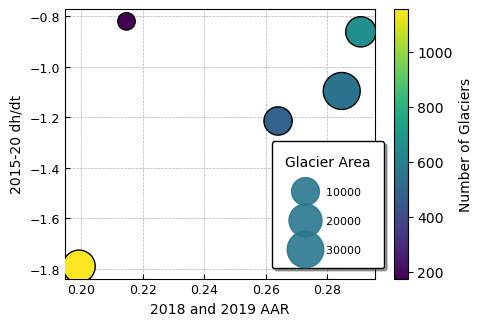

In [242]:
# initial investigation of O2Region stats
fig,axs = plt.subplots(figsize=(5,3.5), dpi=100)

sc = axs.scatter((o2_df['aar_2018']+o2_df['aar_2019'])/2, o2_df['dhdt_1520'], zorder=10,
                    s=4*(o2_df['area']**0.5),
                    c=o2_df['number'],
                    edgecolor='black')

# set tick and label stuff
axs.set_xlabel("2018 and 2019 AAR", fontsize = 10)
axs.set_ylabel("2015-20 dh/dt", fontsize = 10)
axs.tick_params(axis='both', direction='in', labelsize=9)

# add grid
axs.grid(zorder=1, linestyle='dashed', linewidth=0.5)

# format legend for the sizing https://matplotlib.org/stable/gallery/lines_bars_and_markers/scatter_with_legend.html
handles, labels = sc.legend_elements(prop="sizes",
                                     alpha=0.9, num=3, color=sc.cmap(0.4),
                                     func=lambda s: (s/4)**2  )

legend2 = axs.legend(handles, labels, title="Glacier Area",
                     labelspacing=1.5, borderpad=1.2, edgecolor='black', fontsize=8,
                     loc='upper left', bbox_to_anchor=(0.65, 0.53), fancybox=True, shadow=True)

# put colorbar for continuous color scale
plt.colorbar(sc, label='Number of Glaciers')

In [236]:
print(all_data_gdf.columns)#.values
all_data_gdf.head()

Index(['RGIId', 'GLIMSId', 'BgnDate', 'EndDate', 'CenLon', 'CenLat',
       'O1Region', 'O2Region', 'Area', 'Zmin',
       ...
       'O3Region_aa', 'O3Region_aar', 'temp', 'O3Region_dhdt_1520', 'aa_2018',
       'aa_2019', 'aa_2020', 'aa_2021', 'aa_2022', 'temporary'],
      dtype='object', length=306)


,RGIId,GLIMSId,BgnDate,EndDate,CenLon,CenLat,O1Region,O2Region,Area,Zmin,...,O3Region_aa,O3Region_aar,temp,O3Region_dhdt_1520,aa_2018,aa_2019,aa_2020,aa_2021,aa_2022,temporary
0,RGI60-01.00004,G213880E63381N,20090703,-9999999,-146.120,63.381,1,2,3.681,1273,...,593.94922,0.254915,-0.001372,-0.984158,2.128354,0.349695,1.711665,1.322583,1.346142,-0.000226
1,RGI60-01.00005,G212943E63551N,20090703,-9999999,-147.057,63.551,1,2,2.573,1494,...,593.94922,0.254915,0.000274,-0.984158,1.700496,0.332174,1.031773,0.876878,0.586644,0.000045
2,RGI60-01.00006,G213756E63571N,20090703,-9999999,-146.244,63.571,1,2,10.470,1201,...,593.94922,0.254915,0.000923,-0.984158,NaN,NaN,NaN,NaN,NaN,0.000152
3,RGI60-01.00010,G212830E63513N,20090703,-9999999,-147.170,63.513,1,2,3.806,1280,...,593.94922,0.254915,-0.001719,-0.984158,0.839984,0.305241,0.751304,0.440735,0.640550,-0.000283
4,RGI60-01.00012,G213349E63366N,20090703,-9999999,-146.651,63.366,1,2,2.802,1318,...,593.94922,0.254915,-0.001127,-0.984158,0.744491,0.217155,0.698539,0.244615,0.579454,-0.000185


## Let's rejoin some of the regional aggregate stats to the full df

In [299]:
to_join = o3_df[['O3Region','ela_median','aar']].rename({'ela_median':'o3_ela_median','aar':'o3_aar'}, axis=1)
all_data_gdf = gpd.GeoDataFrame(pd.merge(all_data_gdf, to_join, on="O3Region"))

In [309]:
# calculate difference between glacier ela, regional ela
all_data_gdf['o3_ela_anom_g'] = all_data_gdf['ela_median'] - all_data_gdf['o3_ela_median']
all_data_gdf['o3_aar_anom_g'] = all_data_gdf['aar_median'] - all_data_gdf['o3_aar']

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

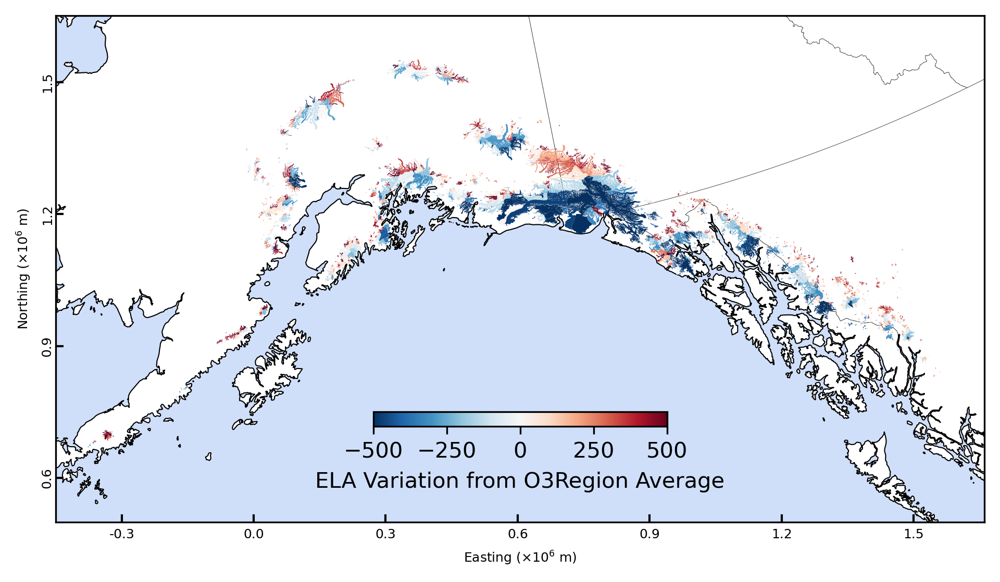

In [308]:
fig,axs = snowFun.create_base_map(hillshade=0)
vmin=-500
vmax=500
cmap='RdBu_r'
all_data_gdf.plot(ax=axs, column='o3_ela_anom_g', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                  legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'ELA Variation from O3Region Average'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

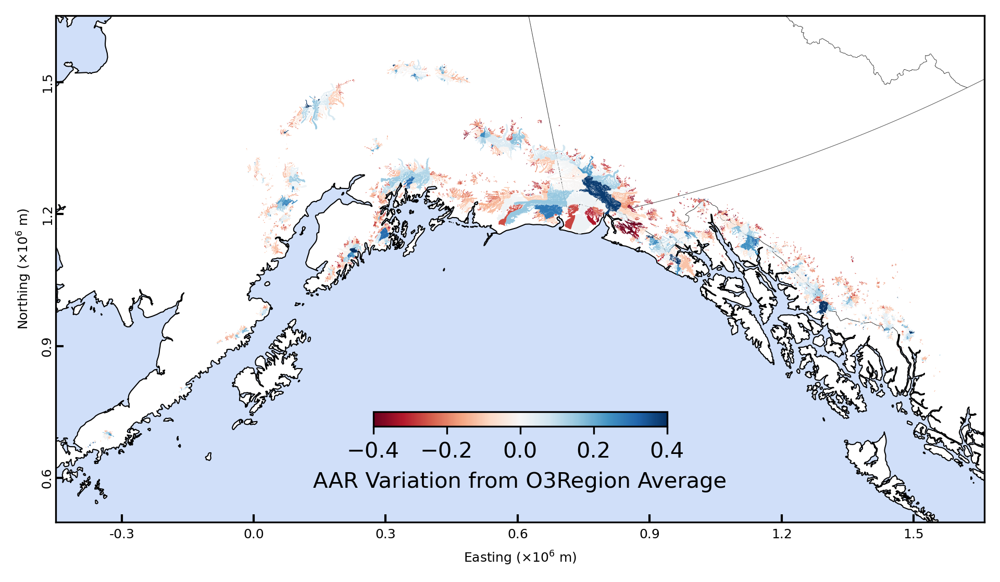

In [311]:
fig,axs = snowFun.create_base_map(hillshade=0)
vmin=-0.4
vmax=0.4
cmap='RdBu'
all_data_gdf.plot(ax=axs, column='o3_aar_anom_g', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                  legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'AAR Variation from O3Region Average'})

2-5: n=1728, area=5286 km2
5-10: n=529, area=3654 km2
10-20: n=288, area=4099 km2
20-40: n=177, area=4991 km2
40-60: n=77, area=3750 km2
60-80: n=33, area=2343 km2
80-100: n=37, area=3277 km2
100-150: n=48, area=5831 km2
150-200: n=27, area=4725 km2
200-300: n=21, area=4988 km2
300-500: n=26, area=10160 km2
500-9999: n=22, area=23396 km2


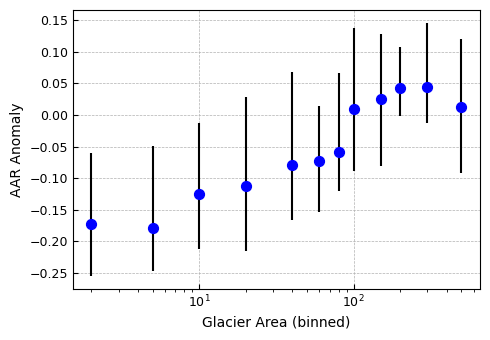

In [357]:
# investigate the AAR variation by glacier size
sizes = [2,5,10,20,40,60,80,100,150,200,300,500,9999]
fig,axs = plt.subplots(figsize=(5,3.5), dpi=100)

for i in range(len(sizes)-1):
   
    # subset to size ranges
    mina = sizes[i]
    maxa = sizes[i+1]
    subset = all_data_gdf[ (all_data_gdf['Area']>=mina) & (all_data_gdf['Area']<maxa)]
    
    # get 25,50,75 percentile
    ps = np.nanpercentile(subset['o3_aar_anom_g'],[25,50,75])
    
    # count number of glaciers
    ns = len(subset)
    areas = int(np.nansum(subset['Area']))
    print(f"{mina}-{maxa}: n={ns}, area={areas} km2")

    # plot
    axs.vlines(mina, ps[0], ps[-1], zorder=2, color='black', linewidth=1.5)
    axs.scatter(mina, ps[1], zorder=5, s=50, c='Blue')
    
# set tick and label stuff
axs.set_xscale('log')
axs.set_xlabel("Glacier Area (binned)", fontsize = 10)
axs.set_ylabel("AAR Anomaly", fontsize = 10)
axs.tick_params(axis='both', direction='in', labelsize=9)

# add grid
axs.grid(zorder=1, linestyle='dashed', linewidth=0.5)

plt.tight_layout()

2-5: n=1728, area=5286 km2
5-10: n=529, area=3654 km2
10-20: n=288, area=4099 km2
20-40: n=177, area=4991 km2
40-60: n=77, area=3750 km2
60-80: n=33, area=2343 km2
80-100: n=37, area=3277 km2
100-150: n=48, area=5831 km2
150-200: n=27, area=4725 km2
200-300: n=21, area=4988 km2
300-500: n=26, area=10160 km2
500-9999: n=22, area=23396 km2


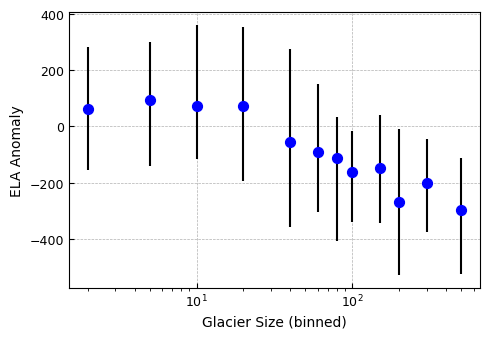

In [413]:
# investigate the ELA variation by glacier size
sizes = [2,5,10,20,40,60,80,100,150,200,300,500,9999]
fig,axs = plt.subplots(figsize=(5,3.5), dpi=100)

for i in range(len(sizes)-1):
   
    # subset to size ranges
    mina = sizes[i]
    maxa = sizes[i+1]
    subset = all_data_gdf[ (all_data_gdf['Area']>=mina) & (all_data_gdf['Area']<maxa)]
    
    # get 25,50,75 percentile
    ps = np.nanpercentile(subset['o3_ela_anom_g'],[25,50,75])
    
    # count number of glaciers
    ns = len(subset)
    areas = int(np.nansum(subset['Area']))
    print(f"{mina}-{maxa}: n={ns}, area={areas} km2")

    # plot
    axs.vlines(mina, ps[0], ps[-1], zorder=2, color='black', linewidth=1.5)
    axs.scatter(mina, ps[1], zorder=5, s=50, c='Blue')
    
# set tick and label stuff
axs.set_xscale('log')
axs.set_xlabel("Glacier Size (binned)", fontsize = 10)
axs.set_ylabel("ELA Anomaly", fontsize = 10)
axs.tick_params(axis='both', direction='in', labelsize=9)

# add grid
axs.grid(zorder=1, linestyle='dashed', linewidth=0.5)

plt.tight_layout()

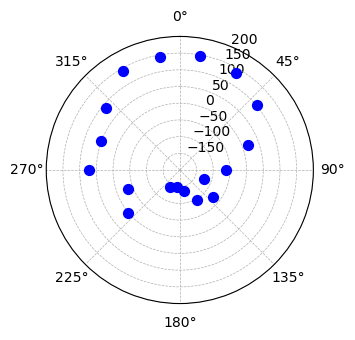

In [393]:
# investigate the ELA variation by aspect
# 0,360=north, 90=east, 180=south, 270=west
aspects = np.arange(0,361,20)
fig,axs = plt.subplots(figsize=(5,3.5), dpi=100,
                       subplot_kw={'projection': 'polar', "theta_offset":np.pi/2, "theta_direction":-1})

for i in range(len(aspects)-1):
    # subset to aspect ranges
    mina = aspects[i]
    maxa = aspects[i+1]
    subset = all_data_gdf[ (all_data_gdf['Aspect']>=mina) & (all_data_gdf['Aspect']<maxa)]
    
    # get 25,50,75 percentile
    ps = np.nanpercentile(subset['o3_ela_anom_g'],[25,50,75])
    
    # count number of glaciers
    ns = len(subset)
    areas = int(np.nansum(subset['Area']))
#     print(f"{mina}-{maxa}: n={ns}, area={areas} km2, data={ps[1]}")

    # plot
    axs.scatter((mina+maxa)/2*np.pi/180, ps[1], zorder=5, s=50, c='Blue')
    

axs.set_rmin(-200)
axs.set_rmax(200)

# add grid
axs.grid(zorder=1, linestyle='dashed', linewidth=0.5)

plt.tight_layout()

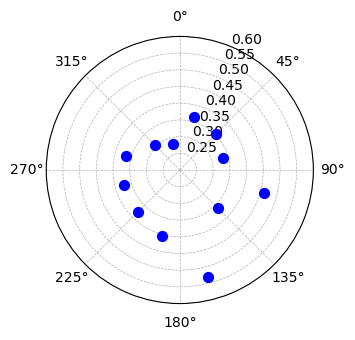

In [412]:
# investigate the AAR variation by aspect
# 0,360=north, 90=east, 180=south, 270=west
aspects = np.arange(0,361,30)
fig,axs = plt.subplots(figsize=(5,3.5), dpi=100,
                       subplot_kw={'projection': 'polar', "theta_offset":np.pi/2, "theta_direction":-1})

for i in range(len(aspects)-1):
    # subset to aspect ranges
    mina = aspects[i]
    maxa = aspects[i+1]
    subset = all_data_gdf[ (all_data_gdf['Aspect']>=mina) & (all_data_gdf['Aspect']<maxa)]
    
    # count number of glaciers
    ns = len(subset)
    areas = int(np.nansum(subset['Area']))
#     print(f"{mina}-{maxa}: n={ns}, area={areas} km2, data={ps[1]}")

    # get total aar of all these glacier
#     aar = np.nansum(subset['o3_aar_anom_g'] * subset['Area']/areas)
    aar = np.nansum(subset['aar_median'] * subset['Area']/areas)

    # plot
    axs.scatter((mina+maxa)/2*np.pi/180, aar, zorder=5, s=50, c='Blue')
    

axs.set_rmin(0.2)
axs.set_rmax(0.6)

# add grid
axs.grid(zorder=1, linestyle='dashed', linewidth=0.5)

plt.tight_layout()

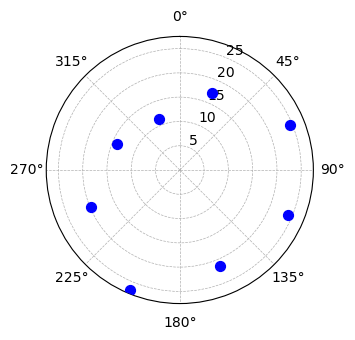

In [437]:
# investigate the glacier size variation by aspect
# 0,360=north, 90=east, 180=south, 270=west
aspects = np.arange(0,361,45)
fig,axs = plt.subplots(figsize=(5,3.5), dpi=100,
                       subplot_kw={'projection': 'polar', "theta_offset":np.pi/2, "theta_direction":-1})

for i in range(len(aspects)-1):
    # subset to aspect ranges
    mina = aspects[i]
    maxa = aspects[i+1]
    theta = (mina+maxa)/2*np.pi/180
    
    subset = all_data_gdf[ (all_data_gdf['Aspect']>=mina) & (all_data_gdf['Aspect']<maxa)]
    subset = subset[subset['Area']<500]
    
    # get 25,50,75 percentile
    ps = np.nanpercentile(subset['Area'],[25,50,75])
    mean = np.nanmean(subset['Area'])
    
    # count number of glaciers
    ns = len(subset)
    areas = int(np.nansum(subset['Area']))
#     print(f"{mina}-{maxa}: n={ns}, area={areas} km2, data={ps[1]}")

    # plot
#     axs.scatter([theta,theta,theta], ps, zorder=5, s=30, c='Black')
    axs.scatter(theta, mean, zorder=5, s=50, c='Blue')
    
# axs.set_rscale('log')
# axs.set_rmin(1)
# axs.set_rmax(20)


# add grid
axs.grid(zorder=1, linestyle='dashed', linewidth=0.5)

plt.tight_layout()

In [362]:
test = all_data_gdf[all_data_gdf['Name']=='Wolverine Glacier']
test["Aspect"]

2100    188
Name: Aspect, dtype: int64

## Start making some pretty figures here

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

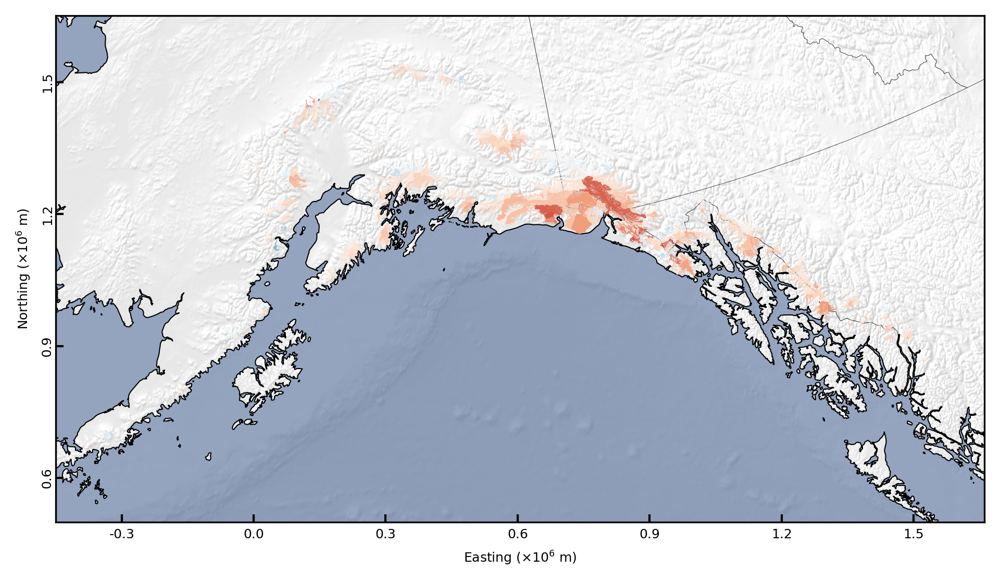

In [301]:
fig,axs = snowFun.create_base_map(hillshade=1)
all_data_gdf.plot(ax=axs, color='red', cmap='prism', zorder=10, legend=False,
                  legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'O3Region'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

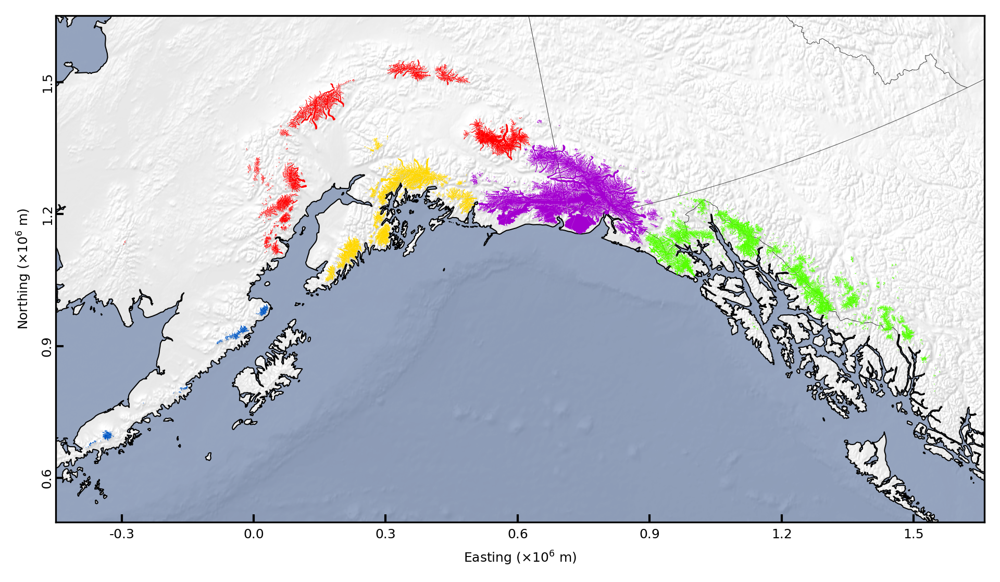

In [11]:
fig,axs = snowFun.create_base_map(hillshade=1)
all_data_gdf.plot(ax=axs, column='O2Region', cmap='prism', zorder=10, legend=False,
                  legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'O3Region'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

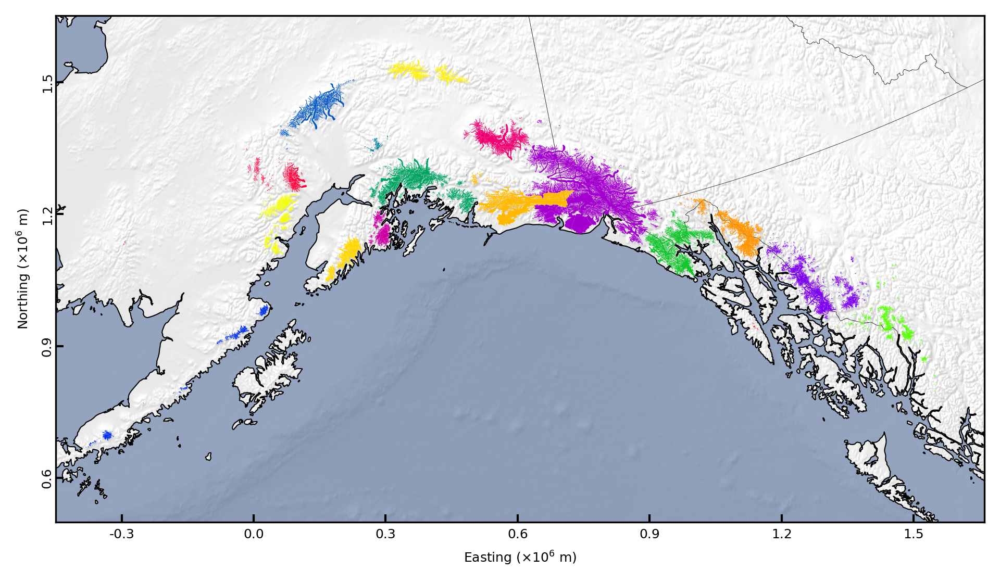

In [12]:
fig,axs = snowFun.create_base_map(hillshade=1)
all_data_gdf.plot(ax=axs, column='O3Region', cmap='prism', zorder=10, legend=False,
                  legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'O3Region'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

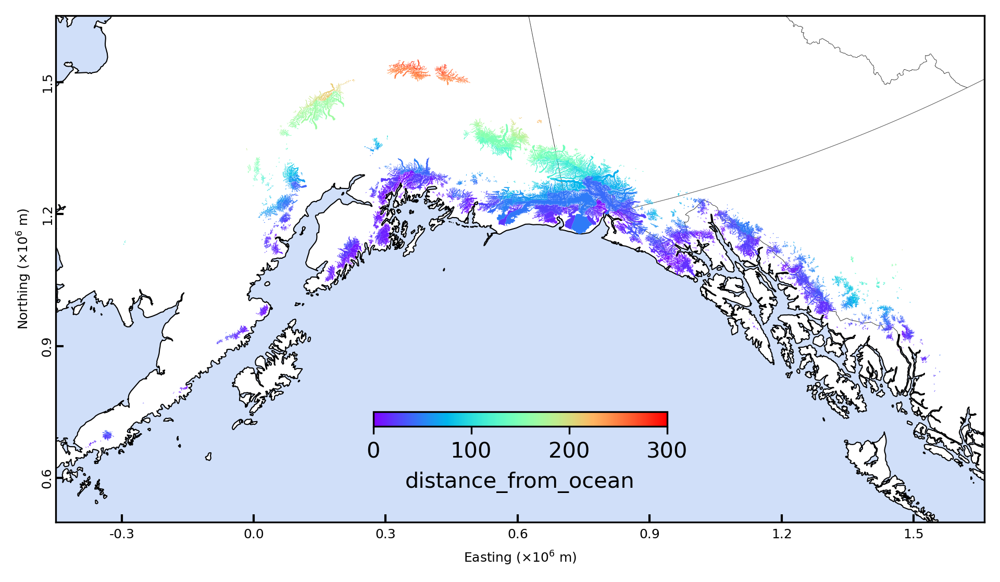

In [118]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='distance_from_ocean', zorder=10, cmap='rainbow', legend=True, vmin=0, vmax=300,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'distance_from_ocean'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

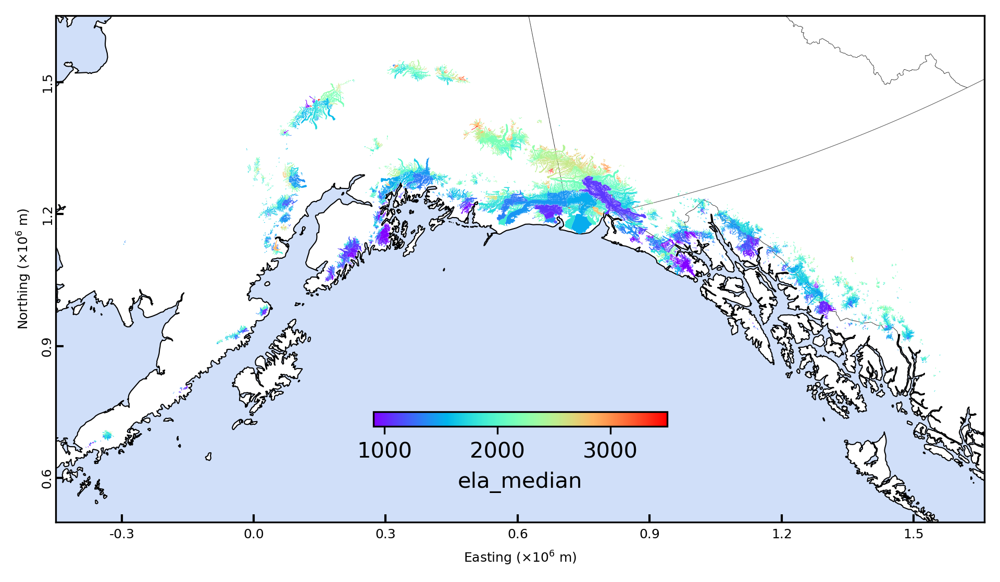

In [88]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='ela_median', zorder=10, cmap='rainbow', legend=True, vmin=900, vmax=3500,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'ela_median'})

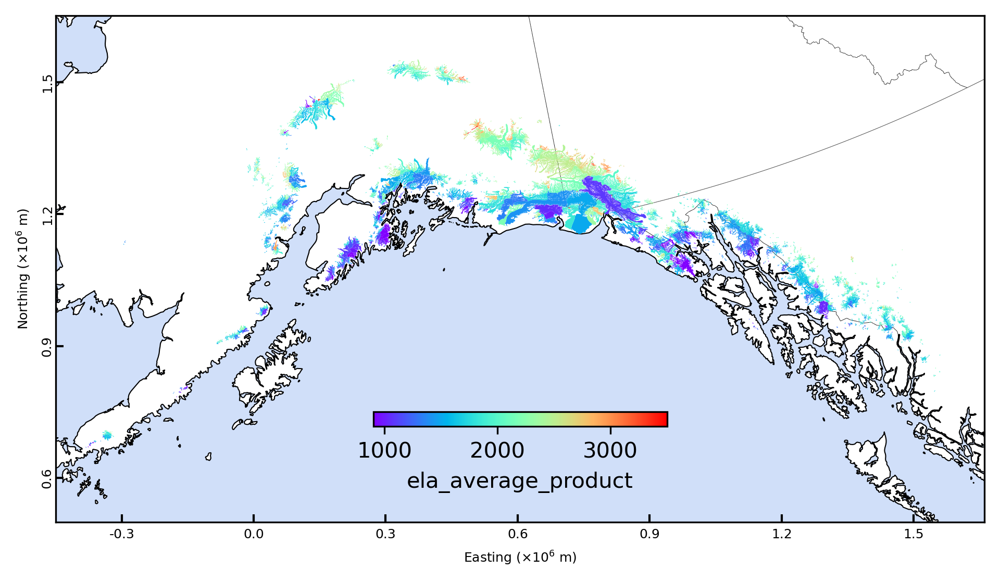

In [87]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='ela_avg_product', zorder=10, cmap='rainbow', vmin=900, vmax=3500, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'ela_average_product'})

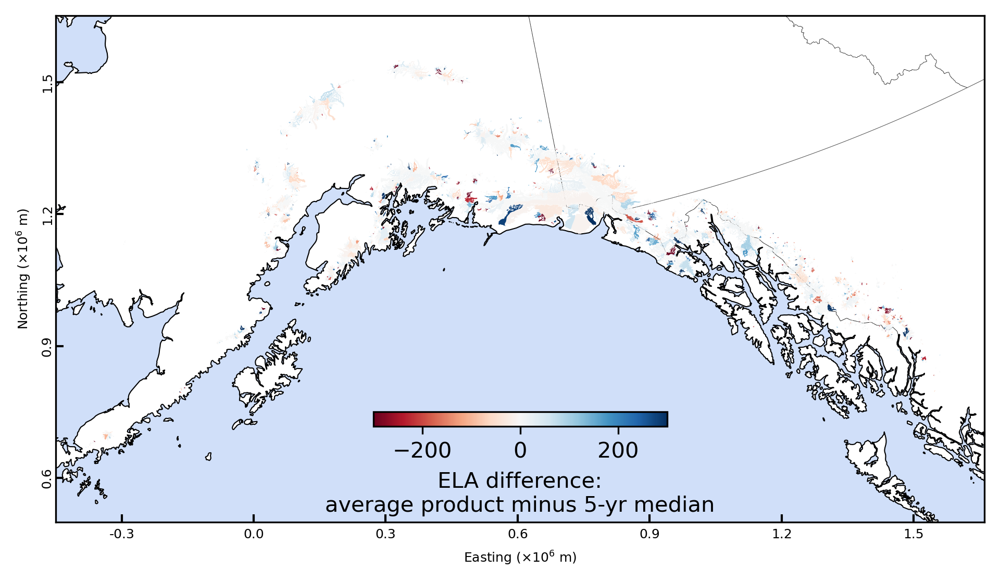

In [92]:
all_data_gdf['temp'] = all_data_gdf["ela_avg_product"]-all_data_gdf['ela_median']
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='temp', zorder=10, cmap='RdBu', vmin=-300, vmax=300, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'ELA difference:\naverage product minus 5-yr median'})

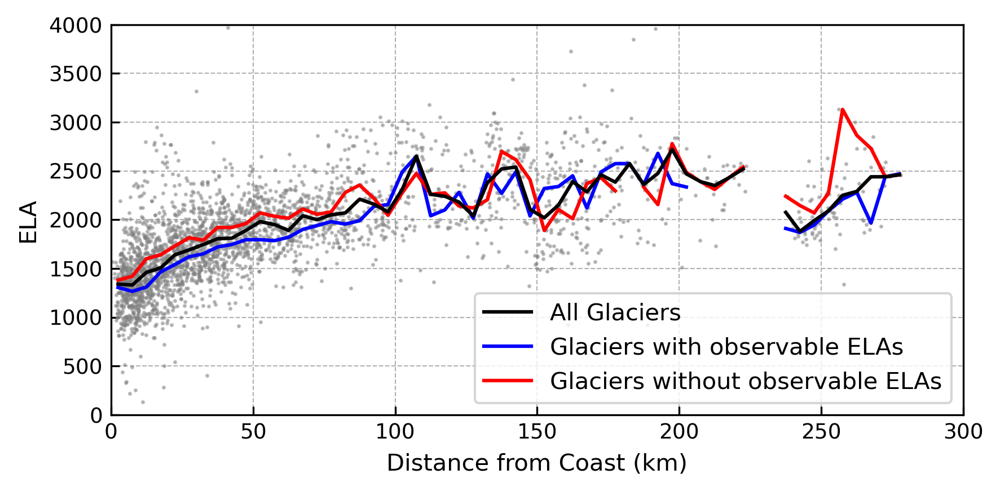

In [177]:
# quick subset to glaciers where ela is on glacier
x = all_data_gdf['distance_from_ocean'][all_data_gdf['off_glacier_avg_product']==0]
y = all_data_gdf['ela_avg_product'][all_data_gdf['off_glacier_avg_product']==0]

# alternate subset for glaciers where ela not on glacier
x2 = all_data_gdf['distance_from_ocean'][all_data_gdf['off_glacier_avg_product']==1]
y2 = all_data_gdf['ela_avg_product'][all_data_gdf['off_glacier_avg_product']==1]

# bin within 5-km bins
bmins = np.arange(0,300,5)
bmaxs = np.arange(5,305,5)
bcenters = (bmins+bmaxs)/2
good_avgs = []
bad_avgs = []
all_avgs = []

for i in range(len(bmins)):
    subset = all_data_gdf[(all_data_gdf['distance_from_ocean']>bmins[i]) & (all_data_gdf['distance_from_ocean']<=bmaxs[i])]
    good_avgs.append( np.nanmedian(subset[subset['off_glacier_avg_product']==0]["ela_avg_product"]) )
    bad_avgs.append( np.nanmedian(subset[subset['off_glacier_avg_product']==1]["ela_avg_product"]) )
    all_avgs.append( np.nanmedian(subset["ela_avg_product"]) )
    
fig, axs = plt.subplots(figsize=(6.5, 3), dpi=300)

# good elas
axs.scatter(x, y, color='grey', s=0.5, alpha=0.5, zorder=3)

# bad elas
axs.scatter(x2, y2, color='grey', s=0.5, alpha=0.5, zorder=2)

# binned series
axs.plot(bcenters, all_avgs, c='Black', zorder=5, label='All Glaciers')
axs.plot(bcenters, good_avgs, c='Blue', zorder=4, label='Glaciers with observable ELAs')
axs.plot(bcenters, bad_avgs, c='Red', zorder=4, label='Glaciers without observable ELAs')


# set tick and label stuff
axs.set_xlim(0,300)
axs.set_ylim(0,4000)
axs.set_xlabel("Distance from Coast (km)", fontsize = 10)
axs.set_ylabel("ELA", fontsize = 10)
axs.tick_params(axis='both', direction='in', labelsize=9)

# add grid
axs.grid(zorder=1, linestyle='dashed', linewidth=0.5)

# add legend
plt.legend()


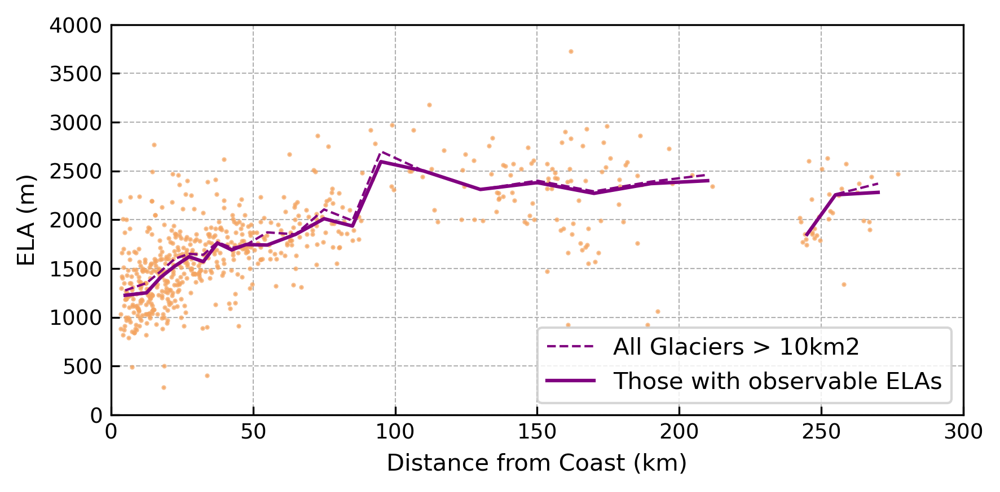

In [217]:
# subset to only the largest glaciers, which we would expect to show the climatic effect of ELA, rather than topography
all_data_subset = all_data_gdf[all_data_gdf['Area']>=10]

# quick subset to glaciers where ela is on glacier
x = all_data_subset['distance_from_ocean'][all_data_subset['off_glacier_avg_product']==0]
y = all_data_subset['ela_avg_product'][all_data_subset['off_glacier_avg_product']==0]

# alternate subset for glaciers where ela not on glacier
x2 = all_data_subset['distance_from_ocean'][all_data_subset['off_glacier_avg_product']==1]
y2 = all_data_subset['ela_avg_product'][all_data_subset['off_glacier_avg_product']==1]

# bin within 5-km bins
bmins = np.arange(0,300,5)
bmaxs = np.arange(5,305,5)

# alternate bins
bmins = np.array( [0,10,15,20,25,30,35,40,45,50,60,70,80,90,100,120,140,160,180,200,220,240,250,260,280] )
bmaxs = np.array(   [10,15,20,25,30,35,40,45,50,60,70,80,90,100,120,140,160,180,200,220,240,250,260,280,300] )
# bmins = np.arange(0,50,5)
# bmins = np.arange(50,100,10)
# bmaxs = np.arange(5,51,5)
# bmaxs = np.arange(60,110,10)
bcenters = (bmins+bmaxs)/2
good_avgs = []
bad_avgs = []
all_avgs = []

for i in range(len(bmins)):
    subset = all_data_subset[(all_data_subset['distance_from_ocean']>bmins[i]) & (all_data_subset['distance_from_ocean']<=bmaxs[i])]
    good_avgs.append( np.nanmedian(subset[subset['off_glacier_avg_product']==0]["ela_avg_product"]) )
    bad_avgs.append( np.nanmedian(subset[subset['off_glacier_avg_product']==1]["ela_avg_product"]) )
    all_avgs.append( np.nanmedian(subset["ela_avg_product"]) )
    
fig, axs = plt.subplots(figsize=(6.5, 3), dpi=300)

# good elas
axs.scatter(x, y, color='sandybrown', marker='o', s=1, alpha=0.7, zorder=3)

# all glaciers
# axs.scatter(all_data_gdf['distance_from_ocean'], all_data_gdf['ela_avg_product'],
#             color='black', marker='.', s=0.1, alpha=0.5, zorder=2)

# bad elas
# axs.scatter(x2, y2, color='grey', s=0.5, alpha=0.5, zorder=2)

# binned series
axs.plot(bcenters, all_avgs, c='purple', linestyle='dashed', linewidth=1, zorder=4, label='All Glaciers > 10km2')
axs.plot(bcenters, good_avgs, c='purple', zorder=5, label='Those with observable ELAs')
# axs.plot(bcenters, bad_avgs, c='Red', zorder=4, label='Glaciers without observable ELAs')


# set tick and label stuff
axs.set_xlim(0,300)
axs.set_ylim(0,4000)
axs.set_xlabel("Distance from Coast (km)", fontsize = 10)
axs.set_ylabel("ELA (m)", fontsize = 10)
axs.tick_params(axis='both', direction='in', labelsize=9)

# add grid
axs.grid(zorder=1, linestyle='dashed', linewidth=0.5)

# add legend
plt.legend()


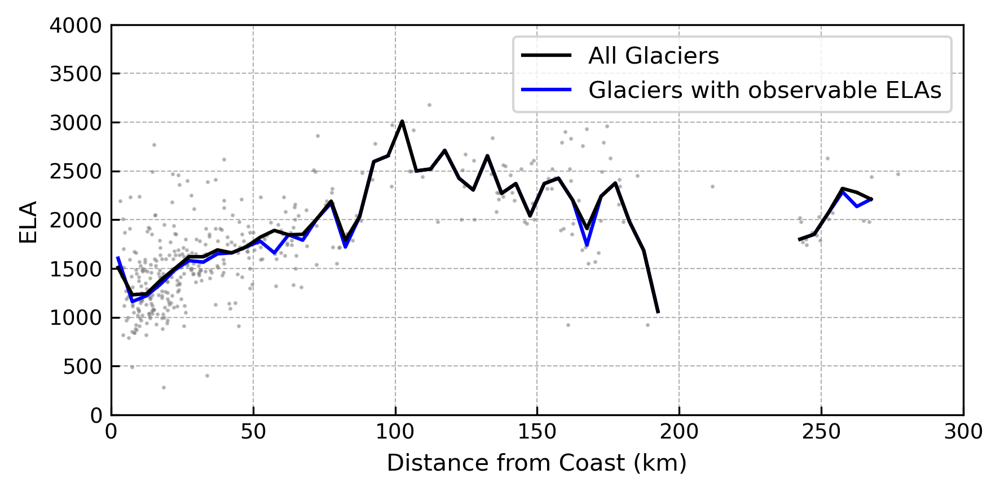

In [181]:
# subset to only the largest glaciers, which we would expect to show the climatic effect of ELA, rather than topography
all_data_subset = all_data_gdf[all_data_gdf['Area']>=20]

# quick subset to glaciers where ela is on glacier
x = all_data_subset['distance_from_ocean'][all_data_subset['off_glacier_avg_product']==0]
y = all_data_subset['ela_avg_product'][all_data_subset['off_glacier_avg_product']==0]

# alternate subset for glaciers where ela not on glacier
x2 = all_data_subset['distance_from_ocean'][all_data_subset['off_glacier_avg_product']==1]
y2 = all_data_subset['ela_avg_product'][all_data_subset['off_glacier_avg_product']==1]

# bin within 5-km bins
bmins = np.arange(0,300,5)
bmaxs = np.arange(5,305,5)
bcenters = (bmins+bmaxs)/2
good_avgs = []
bad_avgs = []
all_avgs = []

for i in range(len(bmins)):
    subset = all_data_subset[(all_data_subset['distance_from_ocean']>bmins[i]) & (all_data_subset['distance_from_ocean']<=bmaxs[i])]
    good_avgs.append( np.nanmedian(subset[subset['off_glacier_avg_product']==0]["ela_avg_product"]) )
    bad_avgs.append( np.nanmedian(subset[subset['off_glacier_avg_product']==1]["ela_avg_product"]) )
    all_avgs.append( np.nanmedian(subset["ela_avg_product"]) )
    
fig, axs = plt.subplots(figsize=(6.5, 3), dpi=300)

# good elas
axs.scatter(x, y, color='grey', s=0.5, alpha=0.5, zorder=3)

# bad elas
# axs.scatter(x2, y2, color='grey', s=0.5, alpha=0.5, zorder=2)

# binned series
axs.plot(bcenters, all_avgs, c='Black', zorder=5, label='All Glaciers')
axs.plot(bcenters, good_avgs, c='Blue', zorder=4, label='Glaciers with observable ELAs')
# axs.plot(bcenters, bad_avgs, c='Red', zorder=4, label='Glaciers without observable ELAs')


# set tick and label stuff
axs.set_xlim(0,300)
axs.set_ylim(0,4000)
axs.set_xlabel("Distance from Coast (km)", fontsize = 10)
axs.set_ylabel("ELA", fontsize = 10)
axs.tick_params(axis='both', direction='in', labelsize=9)

# add grid
axs.grid(zorder=1, linestyle='dashed', linewidth=0.5)

# add legend
plt.legend()


In [223]:
### lets add a column in the df that shows how much off of this best fit line each glacier is
bmins = np.array( [0,10,15,20,25,30,35,40,45,50,60,70,80,90,100,120,140,160,180,200,220,240,250,260,280] )
bmaxs = np.array(   [10,15,20,25,30,35,40,45,50,60,70,80,90,100,120,140,160,180,200,220,240,250,260,280,500] )
expected = good_avgs
lookup_df = pd.DataFrame({'min':bmins, 'max':bmaxs, 'expected':expected})

es = []
anoms = []
for idx, row in all_data_gdf.iterrows():
    d = row['distance_from_ocean']
    e = lookup_df[ (lookup_df['min']<d) & (lookup_df['max']>=d) ]['expected'].values[0]
    anom = row['ela_avg_product'] - e
    es.append(e)
    anoms.append(anom)

all_data_gdf['continentality_expected_ela'] = es
all_data_gdf['continentality_ela_anomaly'] = anoms

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

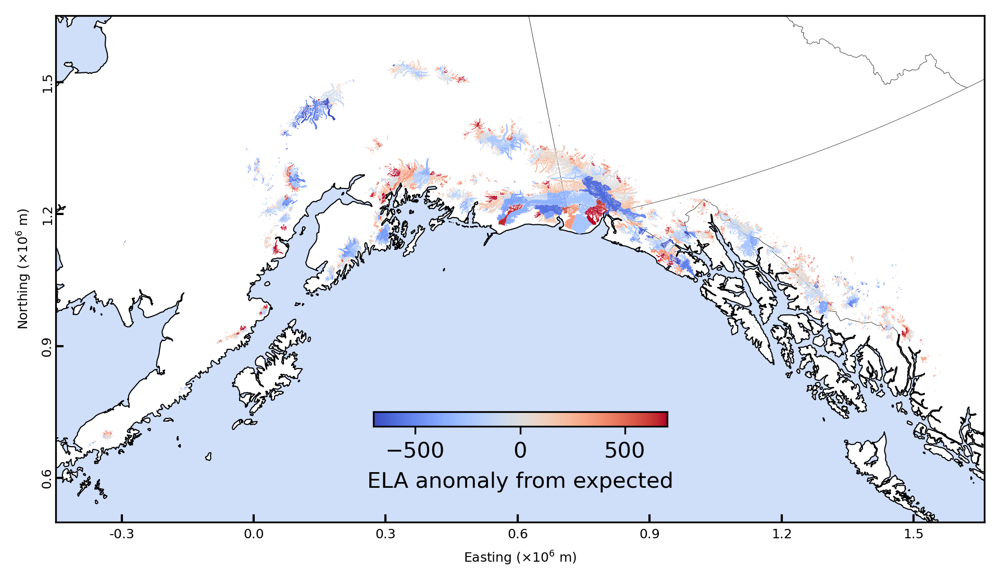

In [227]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='continentality_ela_anomaly', zorder=10, cmap='coolwarm', legend=True, vmin=-700, vmax=700,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'ELA anomaly from expected'})

Text(0.5, 1.0, 'Big Glaciers, valid ELAs')

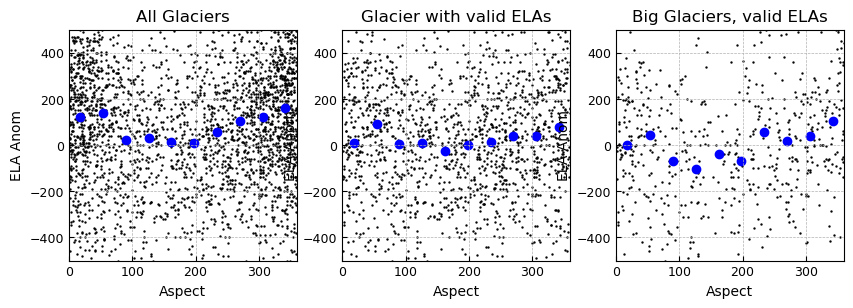

In [334]:
x_char = 'Aspect'
data_char = all_data_gdf[x_char]

fig,axs = plt.subplots(1,3, figsize=(10,3))

# all glaciers
axs[0].scatter(data_char,
            all_data_gdf['continentality_ela_anomaly'],
            s=0.5, c='black')

# good ela glaciers
axs[1].scatter(data_char[all_data_gdf['off_glacier_avg_product']==0],
            all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0],
            s=0.5, c='black')

# good ela and large glaciers 
axs[2].scatter(data_char[(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            s=0.5, c='black')

# split into 10 bins, plot median of each
bins = np.linspace(np.nanmin(data_char), np.nanmax(data_char), num=11)
centers = [np.mean(bins[i:i+2]) for i in range(len(bins)-1)]

# plot binned data for ax1
data = []
subset = all_data_gdf['continentality_ela_anomaly']
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[0].scatter(centers,data, c='blue')

# plot binned data for ax2
data = []
subset = all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[1].scatter(centers,data, c='blue')

# plot binned data for ax3
data = []
subset = all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[2].scatter(centers,data, c='blue')

for ax in axs:
    # set tick and label stuff
    ax.set_ylim(-500,500)
    ax.set_xlim(np.nanmin(data_char), np.nanmax(data_char))
    ax.set_xlabel(x_char, fontsize = 10)
    ax.set_ylabel("ELA Anom", fontsize = 10)
    ax.tick_params(axis='both', direction='in', labelsize=9)
    
    # add grid
    ax.grid(zorder=1, linestyle='dashed', linewidth=0.5)
    
axs[0].set_title('All Glaciers')
axs[1].set_title('Glacier with valid ELAs')
axs[2].set_title('Big Glaciers, valid ELAs')
# add legend
# plt.legend()

# add legend
# plt.legend()

Text(0.5, 1.0, 'Big Glaciers, valid ELAs')

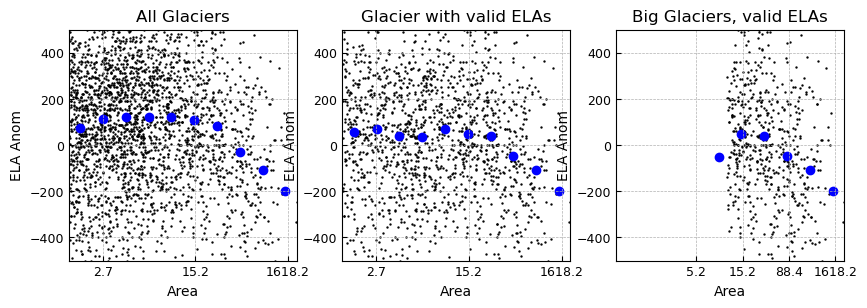

In [336]:
x_char = 'Area'
data_char = np.log(np.log(all_data_gdf[x_char]))

fig,axs = plt.subplots(1,3, figsize=(10,3))
axs[0].scatter(data_char,
            all_data_gdf['continentality_ela_anomaly'],
            s=0.5, c='black')

# large glaciers
axs[1].scatter(data_char[all_data_gdf['off_glacier_avg_product']==0],
            all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0],
            s=0.5, c='black')

# good ela and large glaciers 
axs[2].scatter(data_char[(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            s=0.5, c='black')

# split into 10 bins, plot median of each
bins = np.linspace(np.nanmin(data_char), np.nanmax(data_char), num=11)
centers = [np.mean(bins[i:i+2]) for i in range(len(bins)-1)]

# plot binned data for ax1
data = []
subset = all_data_gdf['continentality_ela_anomaly']
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[0].scatter(centers,data, c='blue')

# plot binned data for ax2
data = []
subset = all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[1].scatter(centers,data, c='blue')

# plot binned data for ax3
data = []
subset = all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[2].scatter(centers,data, c='blue')

for ax in axs:
    # set tick and label stuff
    xticks = ax.get_xticks()
    xticks_new = [round(np.exp(np.exp(i)),1) for i in xticks]
    ax.set_xticks(xticks, xticks_new)
    
    ax.set_ylim(-500,500)
    ax.set_xlim(np.nanmin(data_char), np.nanmax(data_char))
    ax.set_xlabel("Area", fontsize = 10)
    ax.set_ylabel("ELA Anom", fontsize = 10)
    ax.tick_params(axis='both', direction='in', labelsize=9)
    
    # add grid
    ax.grid(zorder=1, linestyle='dashed', linewidth=0.5)
    
axs[0].set_title('All Glaciers')
axs[1].set_title('Glacier with valid ELAs')
axs[2].set_title('Big Glaciers, valid ELAs')
# add legend
# plt.legend()

Text(0.5, 1.0, 'Big Glaciers, valid ELAs')

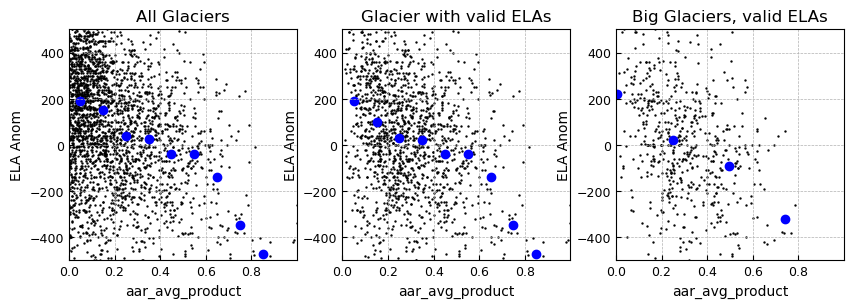

In [337]:
x_char = 'aar_avg_product'
data_char = all_data_gdf[x_char]

fig,axs = plt.subplots(1,3, figsize=(10,3))
axs[0].scatter(data_char,
            all_data_gdf['continentality_ela_anomaly'],
            s=0.5, c='black')

# large glaciers
axs[1].scatter(data_char[all_data_gdf['off_glacier_avg_product']==0],
            all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0],
            s=0.5, c='black')

# good ela and large glaciers 
axs[2].scatter(data_char[(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            s=0.5, c='black')

# plot binned data for ax3
data = []
subset = all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[2].scatter(centers,data, c='blue')

# split into 10 bins, plot median of each
bins = np.linspace(np.nanmin(data_char), np.nanmax(data_char), num=11)
centers = [np.mean(bins[i:i+2]) for i in range(len(bins)-1)]

# plot binned data for ax1
data = []
subset = all_data_gdf['continentality_ela_anomaly']
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[0].scatter(centers,data, c='blue')

# plot binned data for ax2
data = []
subset = all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[1].scatter(centers,data, c='blue')

for ax in axs:
    # set tick and label stuff
    ax.set_ylim(-500,500)
    ax.set_xlim(np.nanmin(data_char), np.nanmax(data_char))
    ax.set_xlabel(x_char, fontsize = 10)
    ax.set_ylabel("ELA Anom", fontsize = 10)
    ax.tick_params(axis='both', direction='in', labelsize=9)
    
    # add grid
    ax.grid(zorder=1, linestyle='dashed', linewidth=0.5)
    
axs[0].set_title('All Glaciers')
axs[1].set_title('Glacier with valid ELAs')
axs[2].set_title('Big Glaciers, valid ELAs')

Text(0.5, 1.0, 'Big Glaciers, valid ELAs')

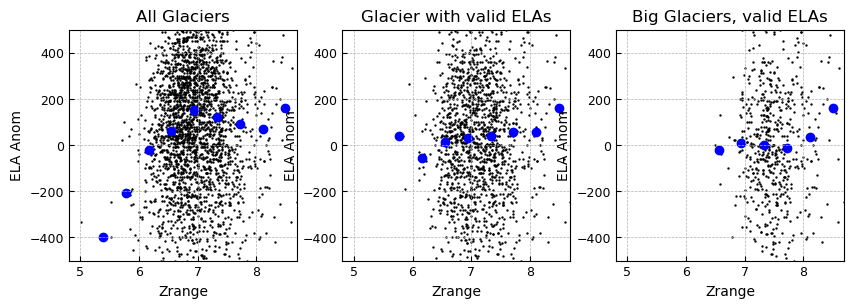

In [338]:
all_data_gdf['Zrange'] = all_data_gdf['Zmax']-all_data_gdf['Zmin']
x_char = 'Zrange'
data_char = np.log(all_data_gdf[x_char])

fig,axs = plt.subplots(1,3, figsize=(10,3))
axs[0].scatter(data_char,
            all_data_gdf['continentality_ela_anomaly'],
            s=0.5, c='black')

# large glaciers
axs[1].scatter(data_char[all_data_gdf['off_glacier_avg_product']==0],
            all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0],
            s=0.5, c='black')

# good ela and large glaciers 
axs[2].scatter(data_char[(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            s=0.5, c='black')

# split into 10 bins, plot median of each
bins = np.linspace(np.nanmin(data_char), np.nanmax(data_char), num=11)
centers = [np.mean(bins[i:i+2]) for i in range(len(bins)-1)]

# plot binned data for ax1
data = []
subset = all_data_gdf['continentality_ela_anomaly']
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[0].scatter(centers,data, c='blue')

# plot binned data for ax2
data = []
subset = all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[1].scatter(centers,data, c='blue')

# plot binned data for ax3
data = []
subset = all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[2].scatter(centers,data, c='blue')

for ax in axs:
    # set tick and label stuff
    ax.set_ylim(-500,500)
    ax.set_xlim(np.nanmin(data_char), np.nanmax(data_char))
    ax.set_xlabel(x_char, fontsize = 10)
    ax.set_ylabel("ELA Anom", fontsize = 10)
    ax.tick_params(axis='both', direction='in', labelsize=9)
    
    # add grid
    ax.grid(zorder=1, linestyle='dashed', linewidth=0.5)
    
axs[0].set_title('All Glaciers')
axs[1].set_title('Glacier with valid ELAs')
axs[2].set_title('Big Glaciers, valid ELAs')

Text(0.5, 1.0, 'Big Glaciers, valid ELAs')

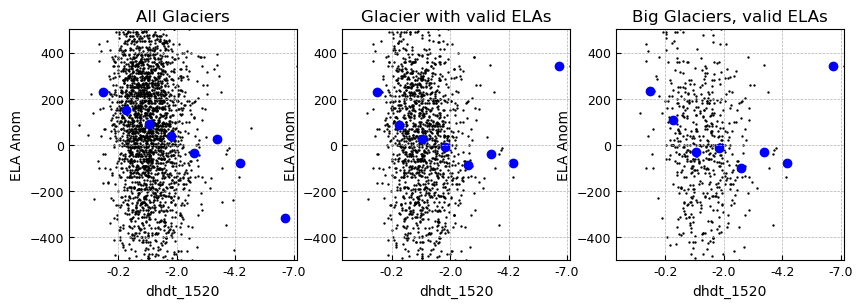

In [342]:
x_char = 'dhdt_1520'
data_char = np.sqrt(all_data_gdf[x_char]*-1+2)

fig,axs = plt.subplots(1,3, figsize=(10,3))
axs[0].scatter(data_char,
            all_data_gdf['continentality_ela_anomaly'],
            s=0.5, c='black')

# large glaciers
axs[1].scatter(data_char[all_data_gdf['off_glacier_avg_product']==0],
            all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0],
            s=0.5, c='black')

# good ela and large glaciers 
axs[2].scatter(data_char[(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            s=0.5, c='black')

# split into 10 bins, plot median of each
bins = np.linspace(np.nanmin(data_char), np.nanmax(data_char), num=11)
centers = [np.mean(bins[i:i+2]) for i in range(len(bins)-1)]

# plot binned data for ax1
data = []
subset = all_data_gdf['continentality_ela_anomaly']
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[0].scatter(centers,data, c='blue')

# plot binned data for ax2
data = []
subset = all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[1].scatter(centers,data, c='blue')

# plot binned data for ax3
data = []
subset = all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[2].scatter(centers,data, c='blue')

for ax in axs:
    # set tick and label stuff
    xticks = ax.get_xticks()
    xticks_new = [round(i**2-2,1)*-1 for i in xticks]
    ax.set_xticks(xticks, xticks_new)
    
    ax.set_ylim(-500,500)
    ax.set_xlim(np.nanmin(data_char), np.nanmax(data_char))
    ax.set_xlabel(x_char, fontsize = 10)
    ax.set_ylabel("ELA Anom", fontsize = 10)
    ax.tick_params(axis='both', direction='in', labelsize=9)
    
    # add grid
    ax.grid(zorder=1, linestyle='dashed', linewidth=0.5)
    
axs[0].set_title('All Glaciers')
axs[1].set_title('Glacier with valid ELAs')
axs[2].set_title('Big Glaciers, valid ELAs')

Text(0.5, 1.0, 'Big Glaciers, valid ELAs')

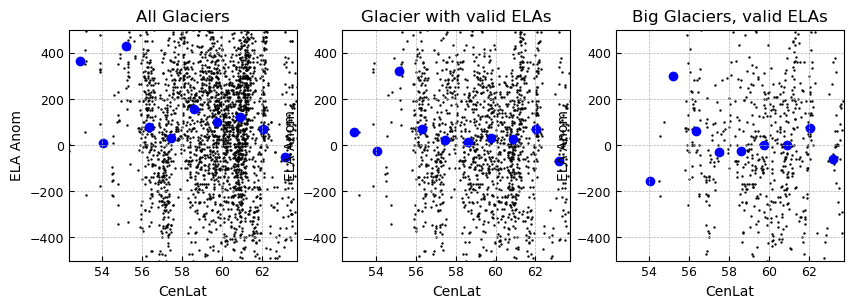

In [340]:
x_char = 'CenLat'
data_char = all_data_gdf[x_char]

fig,axs = plt.subplots(1,3, figsize=(10,3))
axs[0].scatter(data_char,
            all_data_gdf['continentality_ela_anomaly'],
            s=0.5, c='black')

# large glaciers
axs[1].scatter(data_char[all_data_gdf['off_glacier_avg_product']==0],
            all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0],
            s=0.5, c='black')

# good ela and large glaciers 
axs[2].scatter(data_char[(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)],
            s=0.5, c='black')

# split into 10 bins, plot median of each
bins = np.linspace(np.nanmin(data_char), np.nanmax(data_char), num=11)
centers = [np.mean(bins[i:i+2]) for i in range(len(bins)-1)]

# plot binned data for ax1
data = []
subset = all_data_gdf['continentality_ela_anomaly']
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[0].scatter(centers,data, c='blue')

# plot binned data for ax2
data = []
subset = all_data_gdf['continentality_ela_anomaly'][all_data_gdf['off_glacier_avg_product']==0]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[1].scatter(centers,data, c='blue')

# plot binned data for ax3
data = []
subset = all_data_gdf['continentality_ela_anomaly'][(all_data_gdf['off_glacier_avg_product']==0) & (all_data_gdf['Area']>=10)]
for i in range(10):
    data.append( np.nanmedian(subset[ (data_char>=bins[i]) & (data_char<=bins[i+1]) ]) )
axs[2].scatter(centers,data, c='blue')

for ax in axs:
    # set tick and label stuff
#     xticks = ax.get_xticks()
#     xticks_new = [round(i**2-2,1)*-1 for i in xticks]
#     ax.set_xticks(xticks, xticks_new)
    
    ax.set_ylim(-500,500)
    ax.set_xlim(np.nanmin(data_char), np.nanmax(data_char))
    ax.set_xlabel(x_char, fontsize = 10)
    ax.set_ylabel("ELA Anom", fontsize = 10)
    ax.tick_params(axis='both', direction='in', labelsize=9)
    
    # add grid
    ax.grid(zorder=1, linestyle='dashed', linewidth=0.5)
    
axs[0].set_title('All Glaciers')
axs[1].set_title('Glacier with valid ELAs')
axs[2].set_title('Big Glaciers, valid ELAs')

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

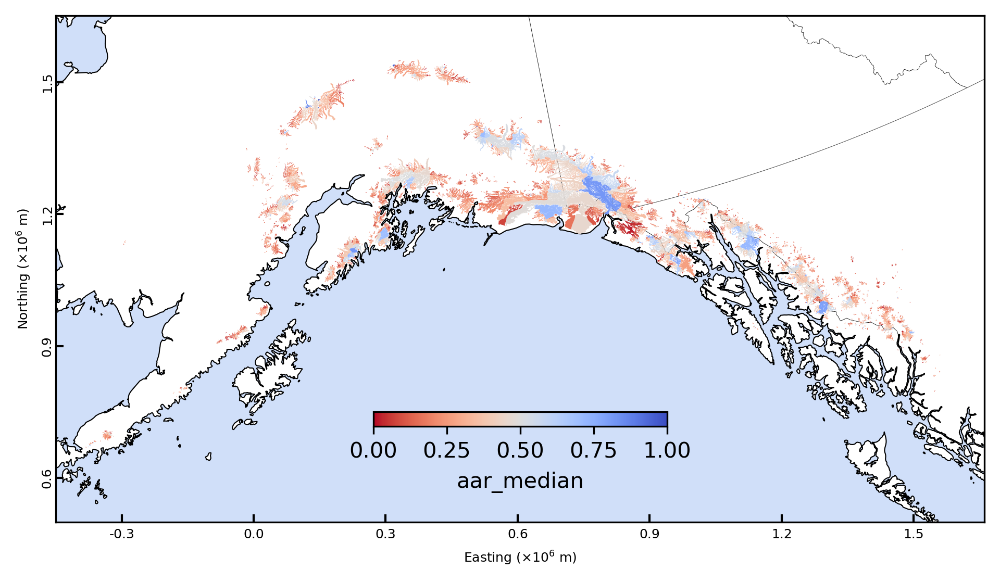

In [100]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='aar_median', zorder=10, cmap='coolwarm_r', legend=True, vmin=0, vmax=1,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'aar_median'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

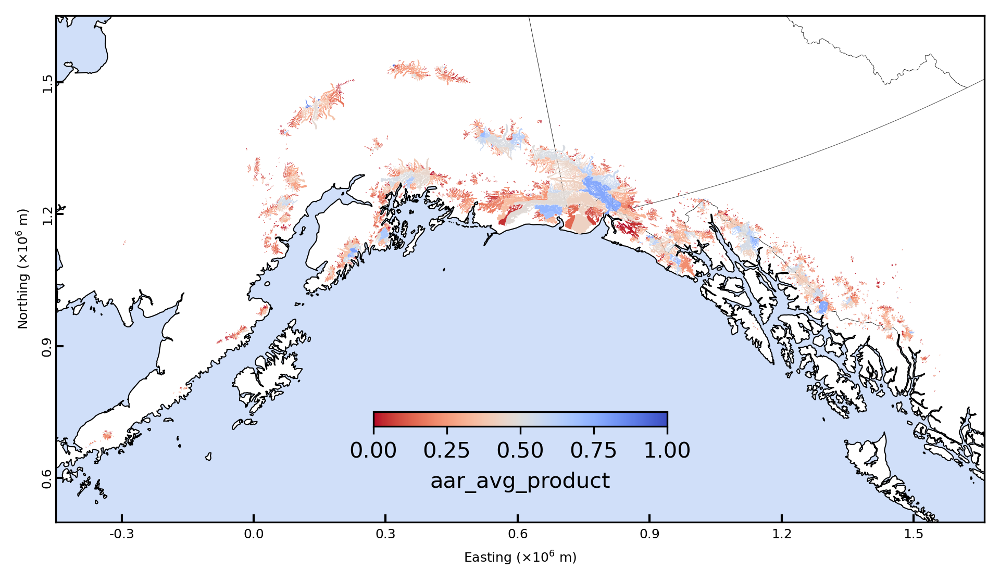

In [101]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='aar_avg_product', zorder=10, cmap='coolwarm_r', legend=True, vmin=0, vmax=1,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'aar_avg_product'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

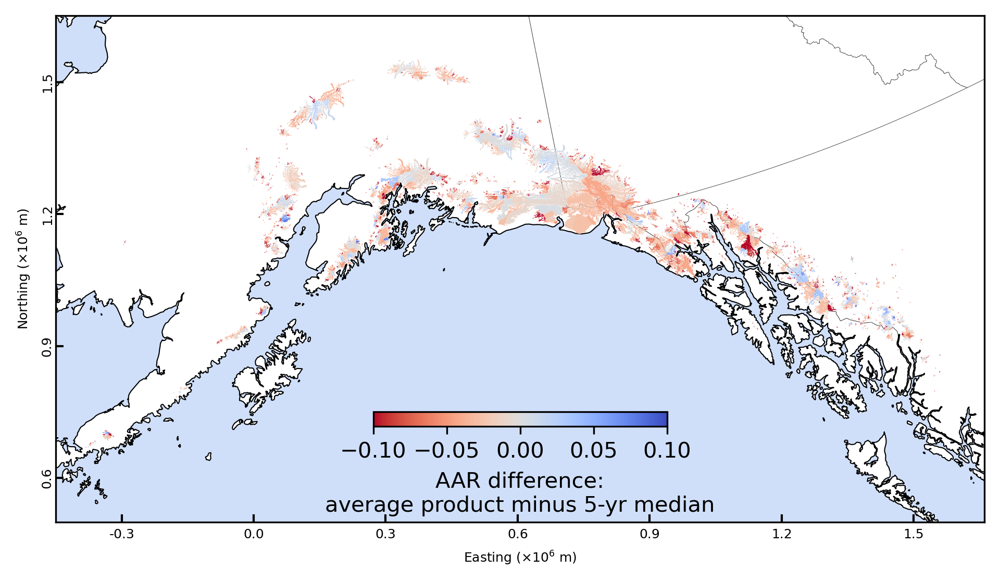

In [106]:
all_data_gdf['temp'] = all_data_gdf["aar_avg_product"]-all_data_gdf['aar_median']
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='temp', zorder=10, cmap='coolwarm_r', legend=True, vmin=-0.1, vmax=0.1,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'AAR difference:\naverage product minus 5-yr median'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

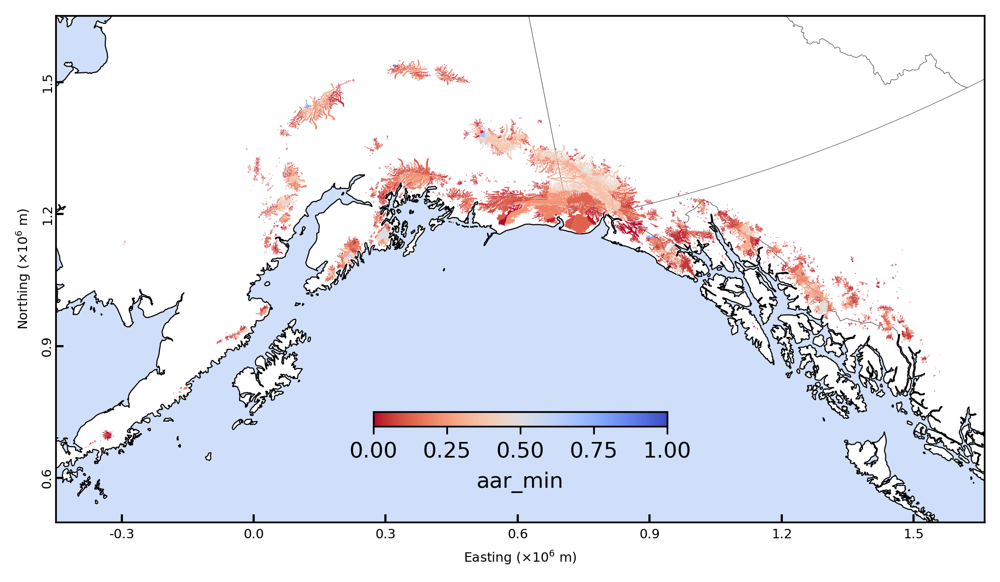

In [14]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='aar_min', zorder=10, cmap='coolwarm_r', legend=True, vmin=0, vmax=1,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'aar_min'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

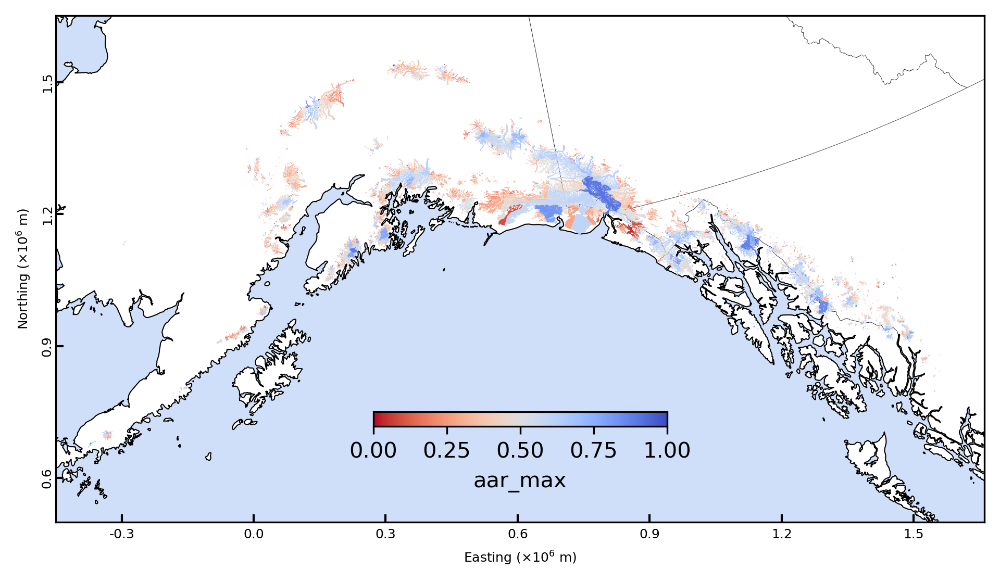

In [15]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='aar_max', zorder=10, cmap='coolwarm_r', legend=True, vmin=0, vmax=1,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'aar_max'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

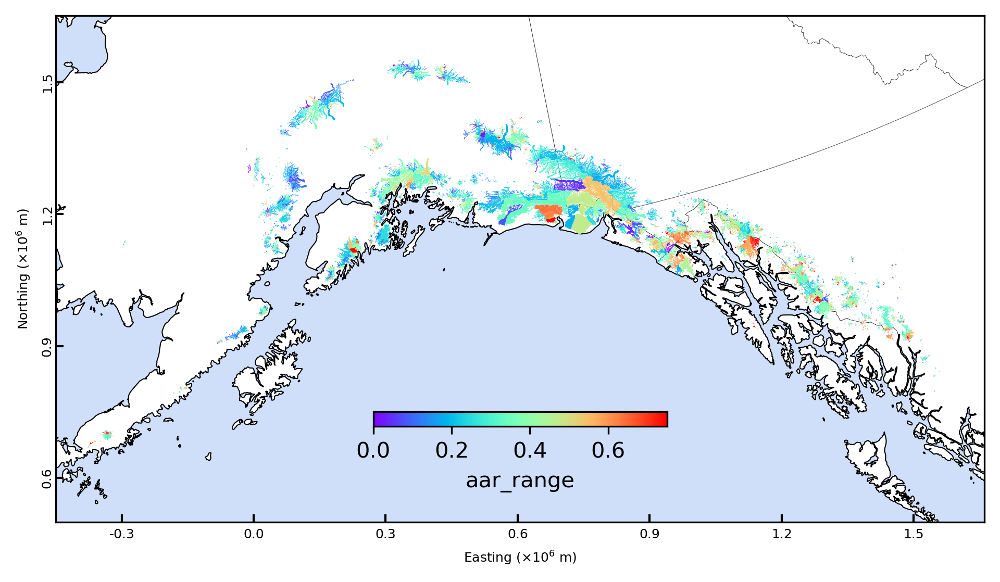

In [70]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='aar_range', zorder=10, cmap='rainbow', legend=True, vmin=0, vmax=0.75,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'aar_range'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

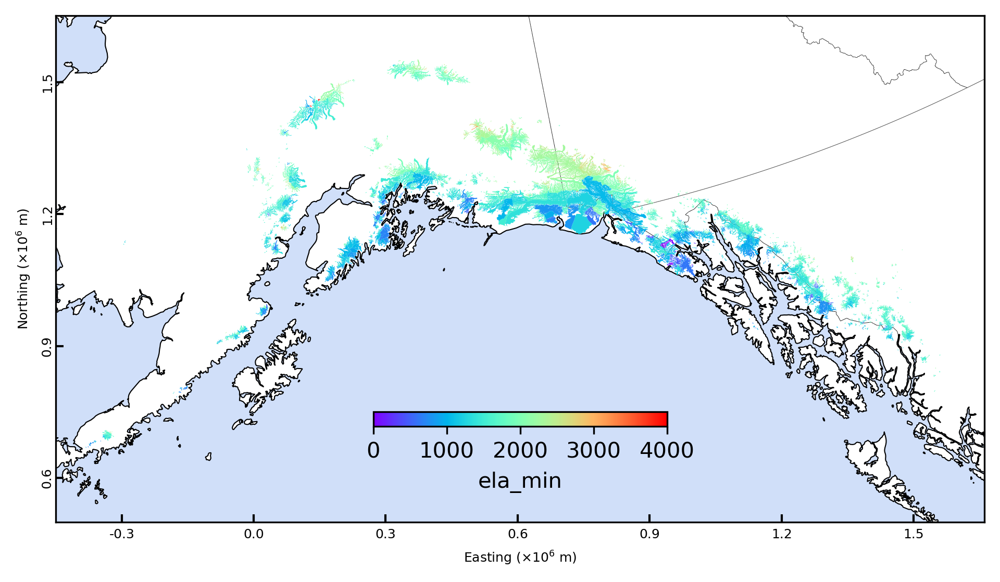

In [24]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='ela_min', zorder=10, cmap='rainbow', legend=True, vmin=0, vmax=4000,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'ela_min'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

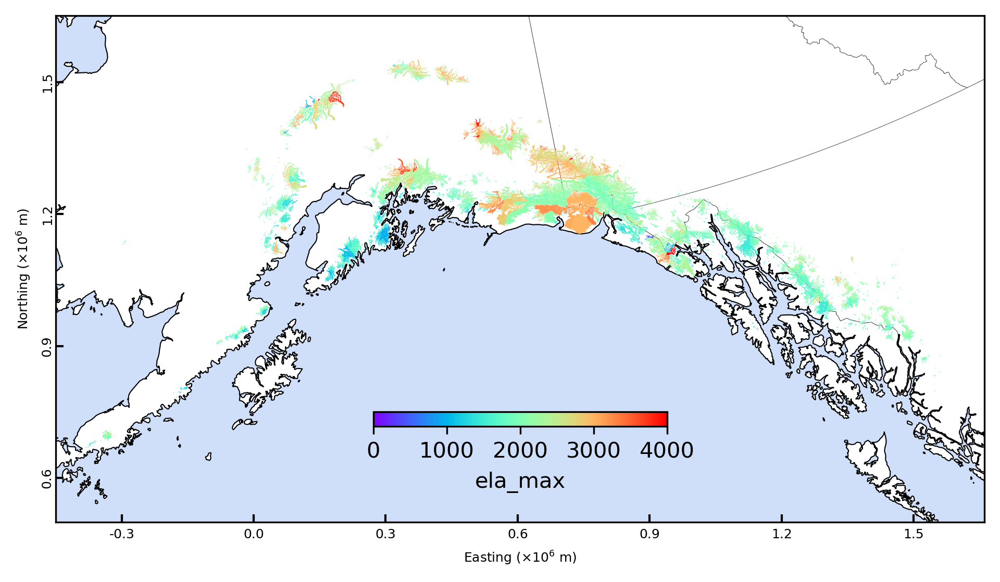

In [25]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='ela_max', zorder=10, cmap='rainbow', legend=True, vmin=0, vmax=4000,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'ela_max'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

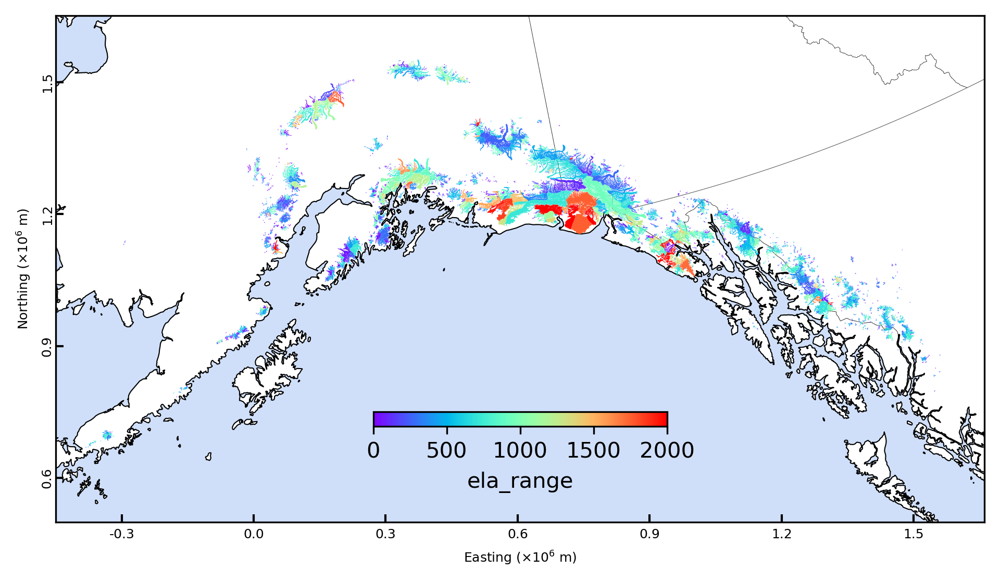

In [71]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='ela_range', zorder=10, cmap='rainbow', legend=True, vmin=0, vmax=2000,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'ela_range'})

<Axes: xlabel='Easting ($ \\times 10^6$ m)', ylabel='Northing ($ \\times 10^6$ m)'>

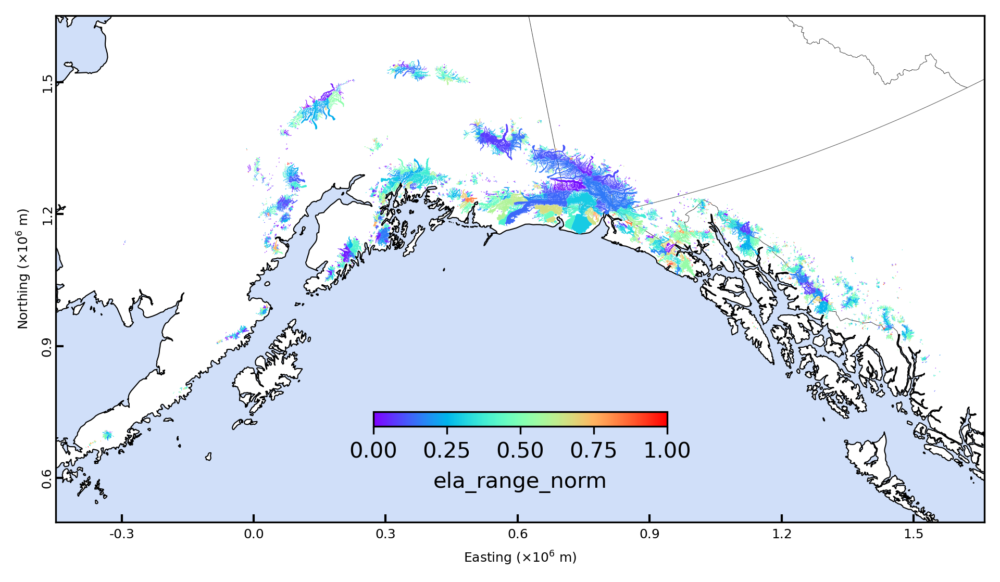

In [29]:
fig,axs = snowFun.create_base_map(hillshade=0)
all_data_gdf.plot(ax=axs, column='ela_range_norm', zorder=10, cmap='rainbow', legend=True, vmin=0, vmax=1,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'ela_range_norm'})

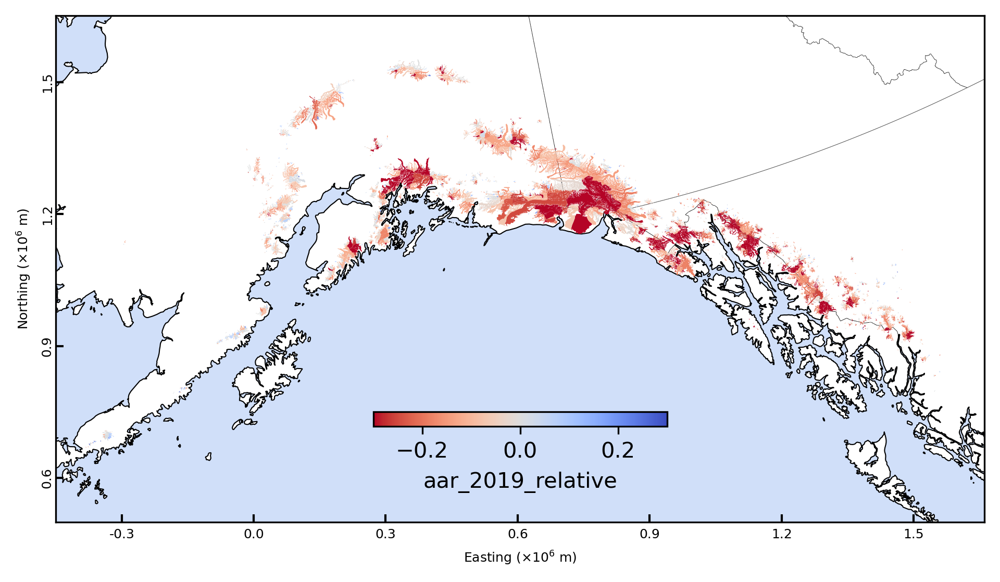

In [15]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='aar_2019_relative', zorder=10, cmap='coolwarm_r', vmin=-0.3, vmax=0.3, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'aar_2019_relative'})

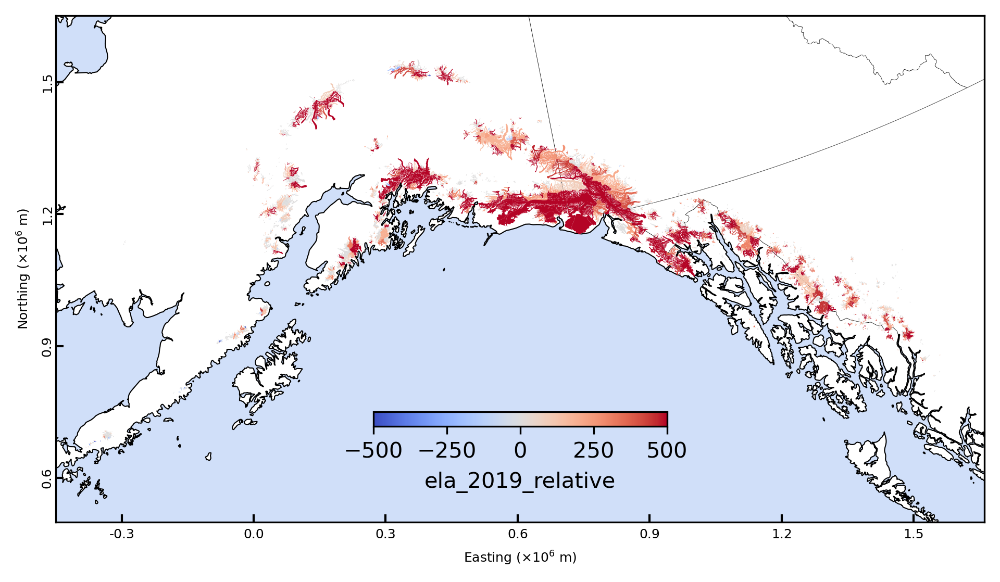

In [16]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='ela_2019_relative', zorder=10, cmap='coolwarm', vmin=-500, vmax=500, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'ela_2019_relative'})

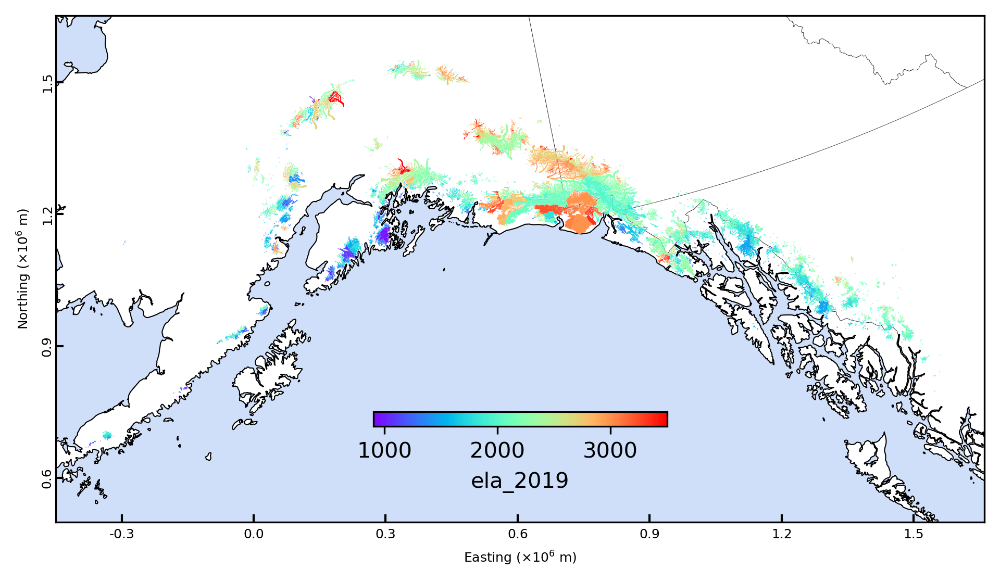

In [73]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='ela_2019', zorder=10, cmap='rainbow', vmin=900, vmax=3500, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'ela_2019'})

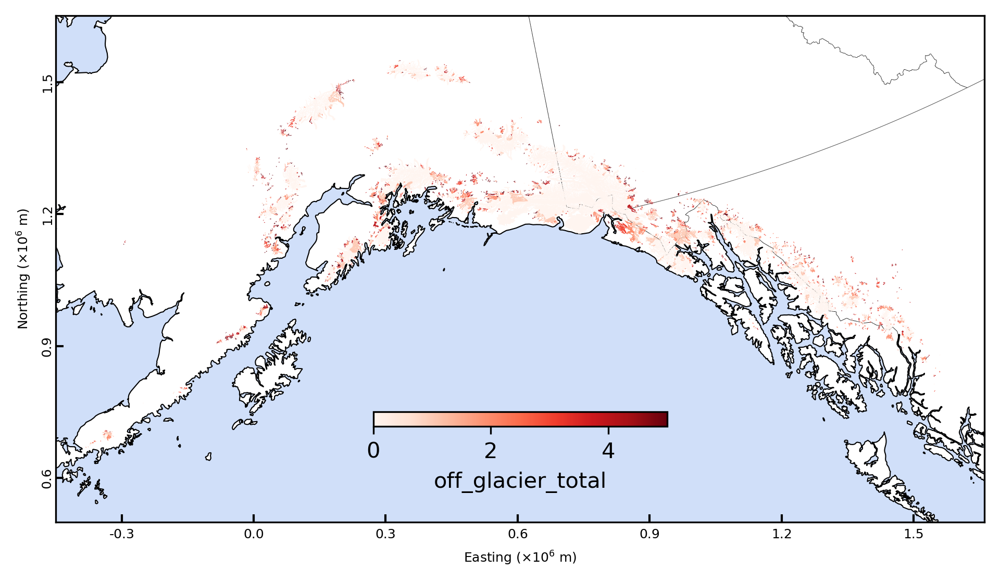

In [97]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='off_glacier_total', zorder=10, cmap='Reds', vmin=0, vmax=5, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'off_glacier_total'})

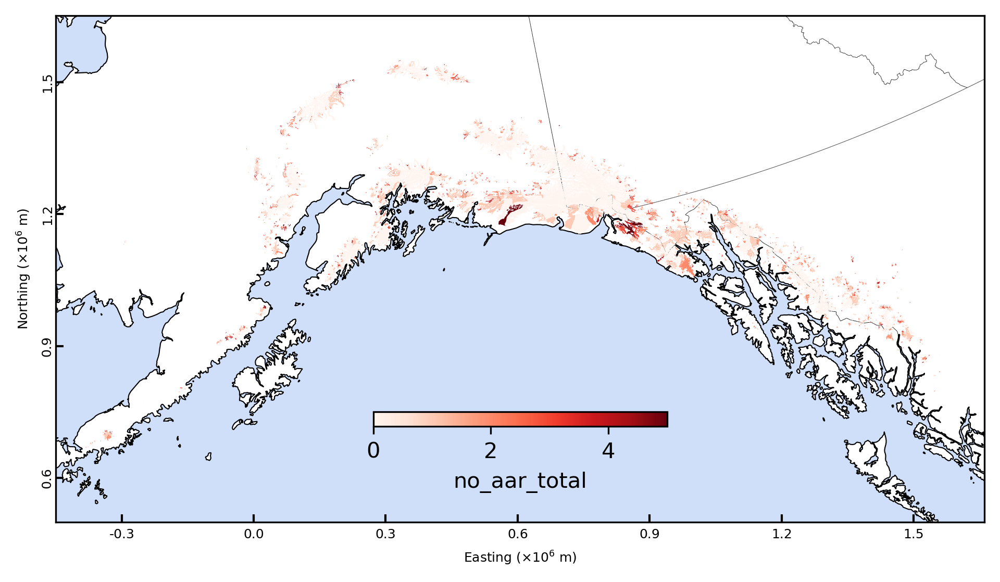

In [98]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='no_aar_total', zorder=10, cmap='Reds', vmin=0, vmax=5, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'no_aar_total'})

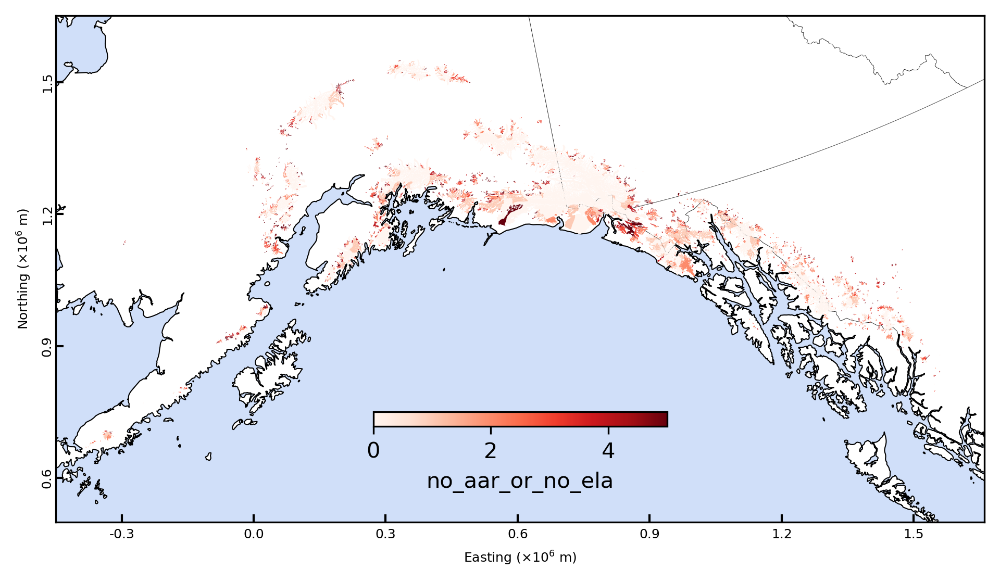

In [99]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='no_aar_or_no_ela', zorder=10, cmap='Reds', vmin=0, vmax=5, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'no_aar_or_no_ela'})

In [61]:
# get stats for what type of glaciers have multiple years of EITHER no arr (<10%) or ela above the glacier elevation
df_deadglaciers = pd.DataFrame()
df_deadglaciers['count'] = all_data_gdf.groupby(['no_aar_or_no_ela'])['Area'].count()
df_deadglaciers['mean_area'] = all_data_gdf.groupby(['no_aar_or_no_ela'])['Area'].mean()
df_deadglaciers['median_area'] = all_data_gdf.groupby(['no_aar_or_no_ela'])['Area'].median()
df_deadglaciers['max_area'] = all_data_gdf.groupby(['no_aar_or_no_ela'])['Area'].max()

df_deadglaciers.head(6)


,count,mean_area,median_area,max_area
no_aar_or_no_ela,,,,
0.0,627,73.980896,7.1680,3362.656
1.0,528,27.962496,6.7545,832.278
2.0,532,12.100075,4.2890,549.286
3.0,407,7.746563,3.5680,206.951
4.0,456,6.314068,3.4685,106.135
5.0,473,6.176801,3.1330,534.228


In [62]:
# get stats for what type of glaciers have multiple years of no arr (<10%)
df_deadglaciers = pd.DataFrame()
df_deadglaciers['count'] = all_data_gdf.groupby(['no_aar_total'])['Area'].count()
df_deadglaciers['mean_area'] = all_data_gdf.groupby(['no_aar_total'])['Area'].mean()
df_deadglaciers['median_area'] = all_data_gdf.groupby(['no_aar_total'])['Area'].median()
df_deadglaciers['max_area'] = all_data_gdf.groupby(['no_aar_total'])['Area'].max()

df_deadglaciers.head(6)

,count,mean_area,median_area,max_area
no_aar_total,,,,
0,1096,47.055333,5.2125,3362.656
1,872,17.631229,4.0550,832.278
2,575,9.429657,3.9150,549.286
3,285,6.922996,3.4910,206.951
4,153,6.318471,3.2780,75.014
5,42,29.339119,4.3545,534.228


In [69]:
# get stats for what type of glaciers have multiple years of no ela above glacier elevation range
df_deadglaciers = pd.DataFrame()
df_deadglaciers['count'] = all_data_gdf.groupby(['off_glacier_total'])['Area'].count()
df_deadglaciers['mean_area'] = all_data_gdf.groupby(['off_glacier_total'])['Area'].mean().round(4)
df_deadglaciers['median_area'] = all_data_gdf.groupby(['off_glacier_total'])['Area'].median()
df_deadglaciers['max_area'] = all_data_gdf.groupby(['off_glacier_total'])['Area'].max()
df_deadglaciers['mean_aar'] = all_data_gdf.groupby(['off_glacier_total'])['aar_median'].mean().round(4)

df_deadglaciers.head(6)

,count,mean_area,median_area,max_area,mean_aar
off_glacier_total,,,,,
0.0,755,72.8035,8.1400,3362.656,0.4122
1.0,548,19.0666,5.8535,488.363,0.3059
2.0,508,9.1902,4.0865,238.307,0.2388
3.0,400,6.7165,3.5165,139.565,0.1444
4.0,399,5.4106,3.3070,106.135,0.1281
5.0,413,3.9032,3.0290,33.297,0.1264


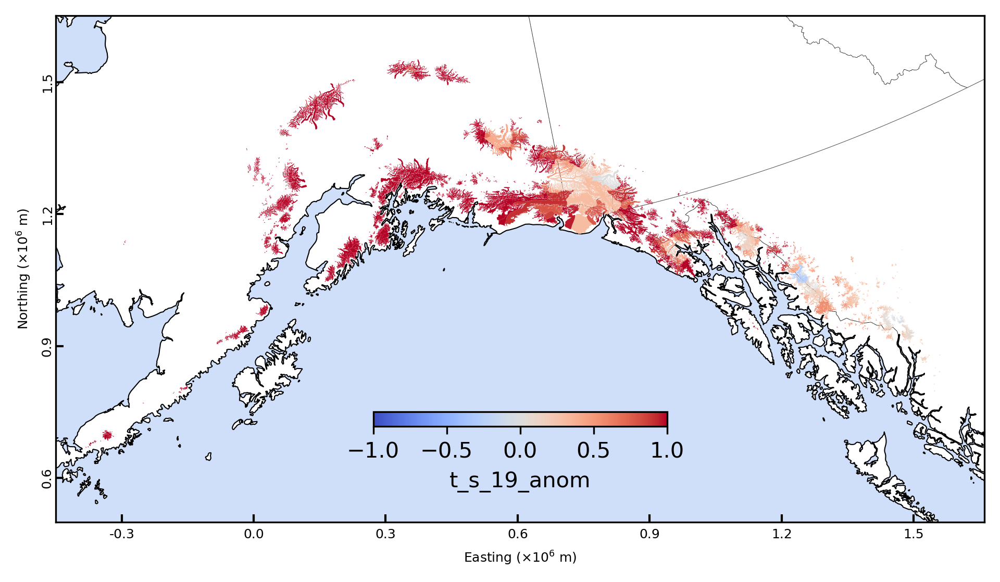

In [19]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='t_s_19_anom', zorder=10, cmap='coolwarm', vmin=-1, vmax=1, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'t_s_19_anom'})

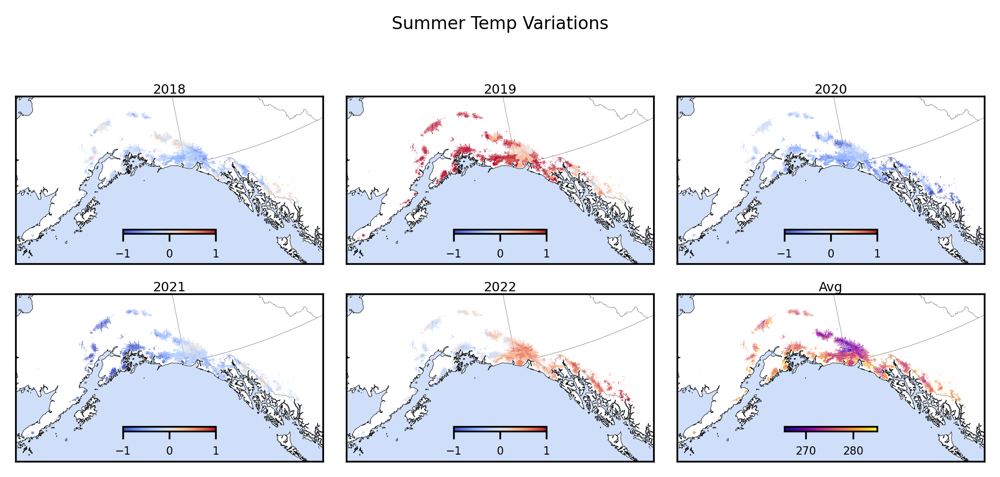

In [20]:
fig,axs = snowFun.create_annual_base_maps(hillshade=0)
ax18,ax19,ax20,ax21,ax22,axav = [a for ax in axs for a in ax] # flatten out everything
all_axs = [ax18,ax19,ax20,ax21,ax22,axav]
vmin=-1
vmax=1

p18 = all_data_gdf.plot(ax=ax18, column='t_s_18_anom', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p19 = all_data_gdf.plot(ax=ax19, column='t_s_19_anom', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p20 = all_data_gdf.plot(ax=ax20, column='t_s_20_anom', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p21 = all_data_gdf.plot(ax=ax21, column='t_s_21_anom', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p22 = all_data_gdf.plot(ax=ax22, column='t_s_22_anom', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

pav = all_data_gdf.plot(ax=axav, column='t_s_avg', zorder=10, cmap='plasma', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

# format colorbar in each axes
for ax in fig.axes[-6:]:
    ax.tick_params(labelsize=5)
    
plt.figtext(0.5,0.9, "Summer Temp Variations", ha='center', size=8)
plt.tight_layout()


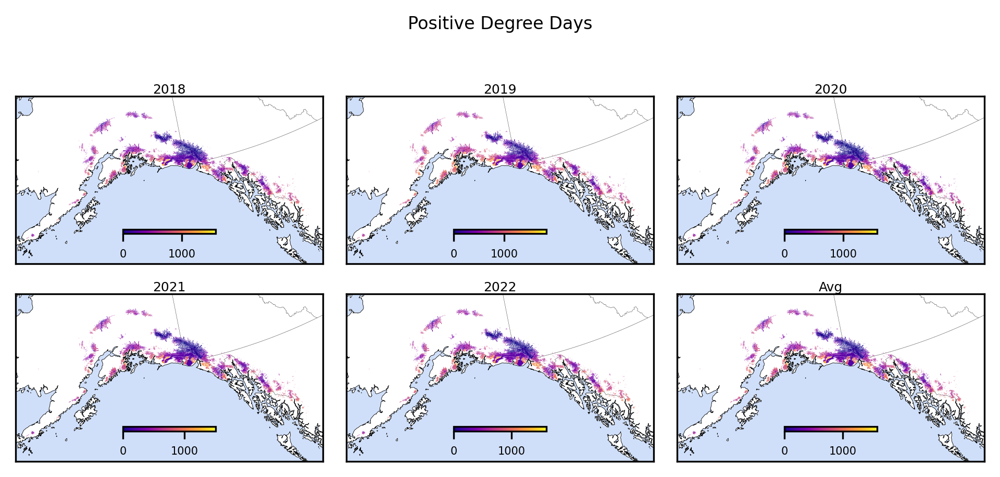

In [21]:
fig,axs = snowFun.create_annual_base_maps(hillshade=0)
ax18,ax19,ax20,ax21,ax22,axav = [a for ax in axs for a in ax] # flatten out everything
all_axs = [ax18,ax19,ax20,ax21,ax22,axav]
vmin=None
vmax=None
cmap='plasma'

p18 = all_data_gdf.plot(ax=ax18, column='pdd_18', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p19 = all_data_gdf.plot(ax=ax19, column='pdd_19', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p20 = all_data_gdf.plot(ax=ax20, column='pdd_20', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p21 = all_data_gdf.plot(ax=ax21, column='pdd_21', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p22 = all_data_gdf.plot(ax=ax22, column='pdd_22', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

pav = all_data_gdf.plot(ax=axav, column='pdd_avg', zorder=10, cmap='plasma', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

# format colorbar in each axes
for ax in fig.axes[-6:]:
    ax.tick_params(labelsize=5)
    
plt.figtext(0.5,0.9, "Positive Degree Days", ha='center', size=8)
plt.tight_layout()

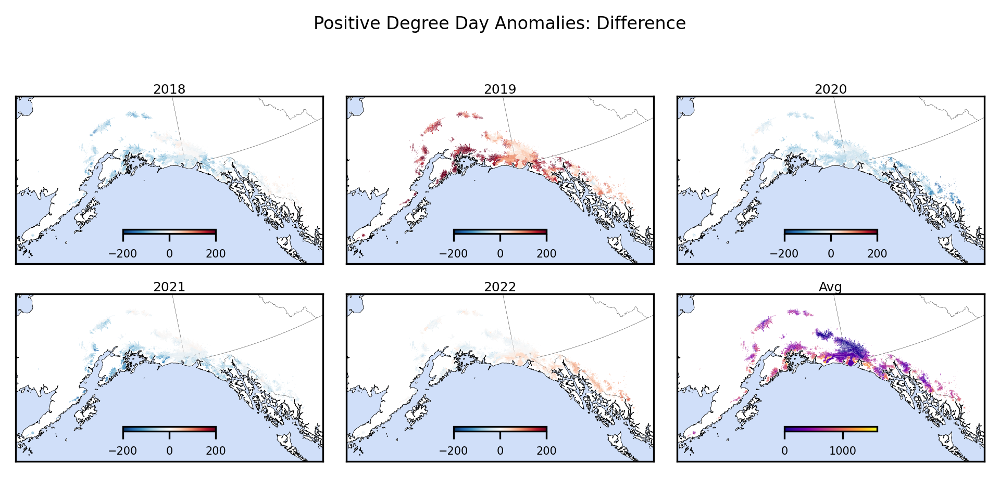

In [22]:
fig,axs = snowFun.create_annual_base_maps(hillshade=0)
ax18,ax19,ax20,ax21,ax22,axav = [a for ax in axs for a in ax] # flatten out everything
all_axs = [ax18,ax19,ax20,ax21,ax22,axav]
vmin=-200
vmax=200
cmap='RdBu_r'

p18 = all_data_gdf.plot(ax=ax18, column='pdd_18_anom_diff', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p19 = all_data_gdf.plot(ax=ax19, column='pdd_19_anom_diff', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p20 = all_data_gdf.plot(ax=ax20, column='pdd_20_anom_diff', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p21 = all_data_gdf.plot(ax=ax21, column='pdd_21_anom_diff', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p22 = all_data_gdf.plot(ax=ax22, column='pdd_22_anom_diff', zorder=10, cmap=cmap, vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

pav = all_data_gdf.plot(ax=axav, column='pdd_avg', zorder=10, cmap='plasma', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

# format colorbar in each axes
for ax in fig.axes[-6:]:
    ax.tick_params(labelsize=5)
    
plt.figtext(0.5,0.9, "Positive Degree Day Anomalies: Difference", ha='center', size=8)
plt.tight_layout()

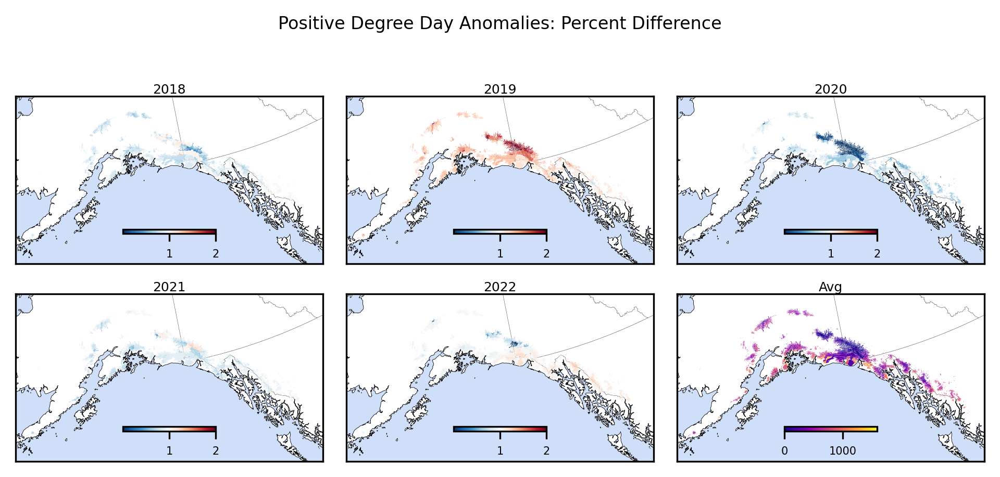

In [23]:
fig,axs = snowFun.create_annual_base_maps(hillshade=0)
ax18,ax19,ax20,ax21,ax22,axav = [a for ax in axs for a in ax] # flatten out everything
all_axs = [ax18,ax19,ax20,ax21,ax22,axav]

vmin=0.5
vmax=2
cmap='RdBu_r'

vcenter=1
norm = TwoSlopeNorm(vmin=vmin, vcenter=vcenter, vmax=vmax)
    
p18 = all_data_gdf.plot(ax=ax18, column='pdd_18_anom_frac', zorder=10, cmap=cmap, norm=norm, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p19 = all_data_gdf.plot(ax=ax19, column='pdd_19_anom_frac', zorder=10, cmap=cmap, norm=norm, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p20 = all_data_gdf.plot(ax=ax20, column='pdd_20_anom_frac', zorder=10, cmap=cmap, norm=norm, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p21 = all_data_gdf.plot(ax=ax21, column='pdd_21_anom_frac', zorder=10, cmap=cmap, norm=norm, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p22 = all_data_gdf.plot(ax=ax22, column='pdd_22_anom_frac', zorder=10, cmap=cmap, norm=norm, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

pav = all_data_gdf.plot(ax=axav, column='pdd_avg', zorder=10, cmap='plasma', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

# format colorbar in each axes
for ax in fig.axes[-6:]:
    ax.tick_params(labelsize=5)
    
plt.figtext(0.5,0.9, "Positive Degree Day Anomalies: Percent Difference", ha='center', size=8)
plt.tight_layout()

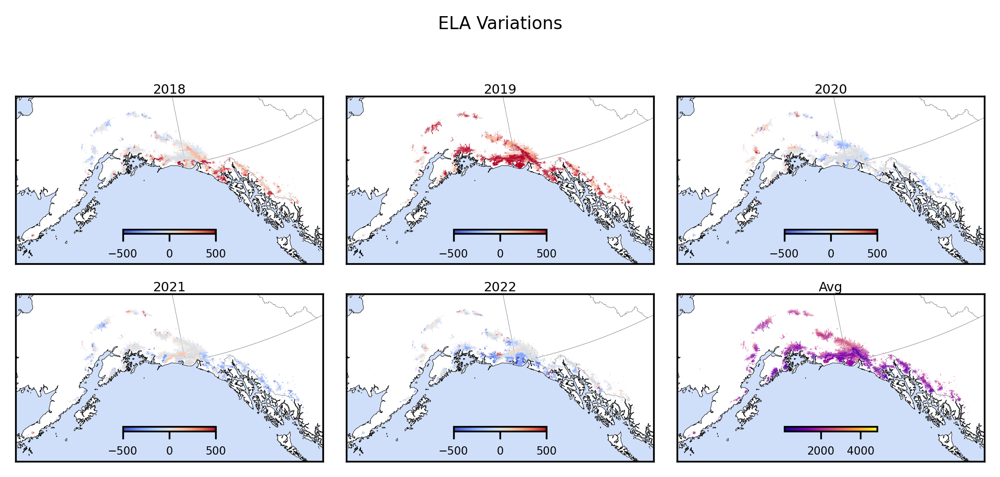

In [24]:
fig,axs = snowFun.create_annual_base_maps(hillshade=0)
ax18,ax19,ax20,ax21,ax22,axav = [a for ax in axs for a in ax] # flatten out everything
all_axs = [ax18,ax19,ax20,ax21,ax22,axav]
vmin=-500
vmax=500

p18 = all_data_gdf.plot(ax=ax18, column='ela_2018_relative', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p19 = all_data_gdf.plot(ax=ax19, column='ela_2019_relative', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p20 = all_data_gdf.plot(ax=ax20, column='ela_2020_relative', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p21 = all_data_gdf.plot(ax=ax21, column='ela_2021_relative', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p22 = all_data_gdf.plot(ax=ax22, column='ela_2022_relative', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

pav = all_data_gdf.plot(ax=axav, column='ela_median', zorder=10, cmap='plasma', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

# format colorbar in each axes
for ax in fig.axes[-6:]:
    ax.tick_params(labelsize=5)
    
plt.figtext(0.5,0.9, "ELA Variations", ha='center', size=8)
plt.tight_layout()


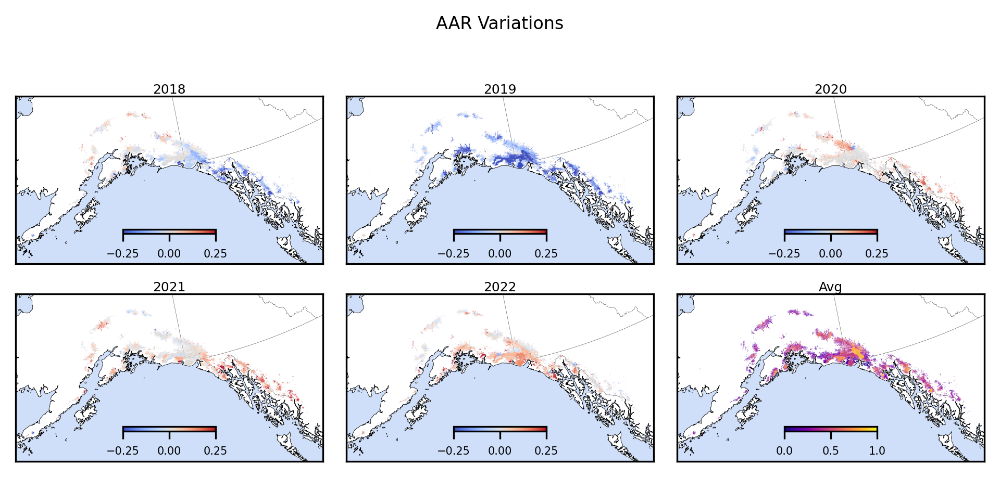

In [25]:
fig,axs = snowFun.create_annual_base_maps(hillshade=0)
ax18,ax19,ax20,ax21,ax22,axav = [a for ax in axs for a in ax] # flatten out everything
all_axs = [ax18,ax19,ax20,ax21,ax22,axav]
vmin=-0.25
vmax=0.25

p18 = all_data_gdf.plot(ax=ax18, column='aar_2018_relative', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p19 = all_data_gdf.plot(ax=ax19, column='aar_2019_relative', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p20 = all_data_gdf.plot(ax=ax20, column='aar_2020_relative', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p21 = all_data_gdf.plot(ax=ax21, column='aar_2021_relative', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p22 = all_data_gdf.plot(ax=ax22, column='aar_2022_relative', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

pav = all_data_gdf.plot(ax=axav, column='aar_median', vmin=0, vmax=1, zorder=10, cmap='plasma', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

# format colorbar in each axes
for ax in fig.axes[-6:]:
    ax.tick_params(labelsize=5)
    
plt.figtext(0.5,0.9, "AAR Variations", ha='center', size=8)
plt.tight_layout()


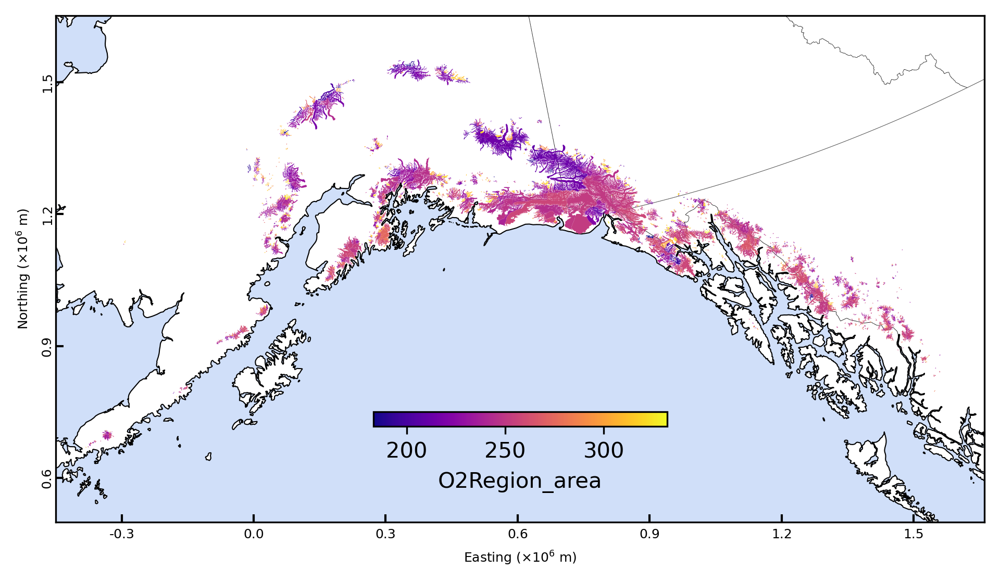

In [26]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='doy_median', zorder=10, cmap='plasma', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'O2Region_area'})

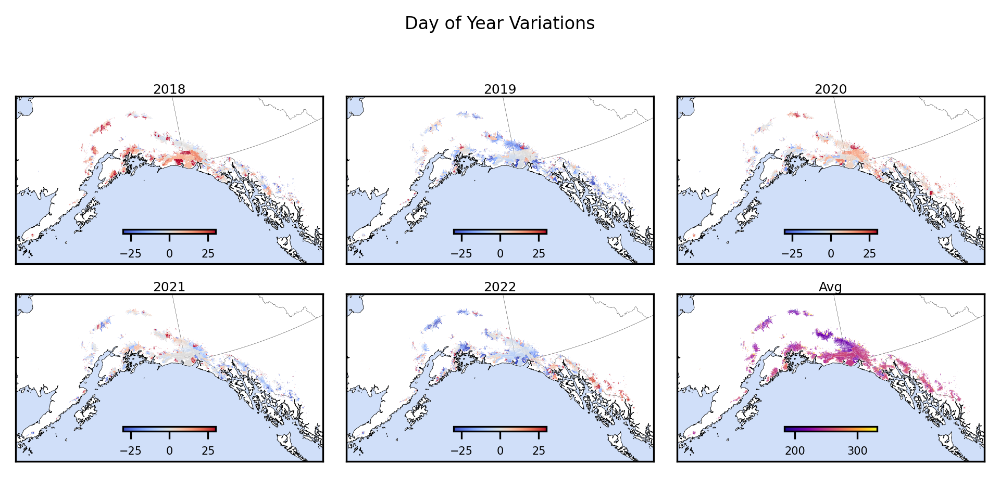

In [27]:
fig,axs = snowFun.create_annual_base_maps(hillshade=0)
ax18,ax19,ax20,ax21,ax22,axav = [a for ax in axs for a in ax] # flatten out everything
all_axs = [ax18,ax19,ax20,ax21,ax22,axav]
vmin=-30
vmax=30

p18 = all_data_gdf.plot(ax=ax18, column='doy_2018_anom', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p19 = all_data_gdf.plot(ax=ax19, column='doy_2019_anom', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p20 = all_data_gdf.plot(ax=ax20, column='doy_2020_anom', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p21 = all_data_gdf.plot(ax=ax21, column='doy_2021_anom', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

p22 = all_data_gdf.plot(ax=ax22, column='doy_2022_anom', zorder=10, cmap='coolwarm', vmin=vmin, vmax=vmax, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

pav = all_data_gdf.plot(ax=axav, column='doy_median', zorder=10, cmap='plasma', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15})

# format colorbar in each axes
for ax in fig.axes[-6:]:
    ax.tick_params(labelsize=5)
    
plt.figtext(0.5,0.9, "Day of Year Variations", ha='center', size=8)
plt.tight_layout()

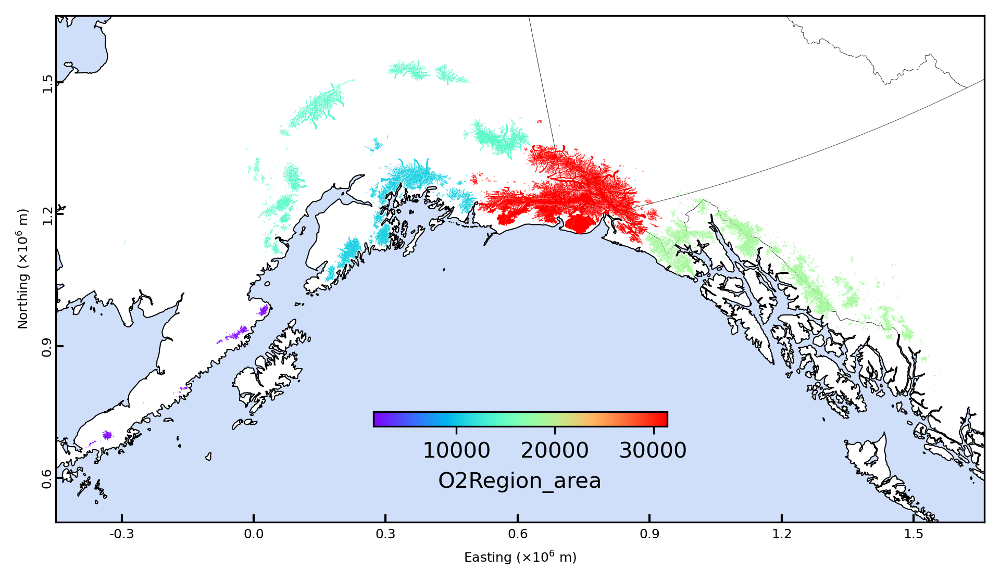

In [28]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='O2Region_area', zorder=10, cmap='rainbow', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'O2Region_area'})

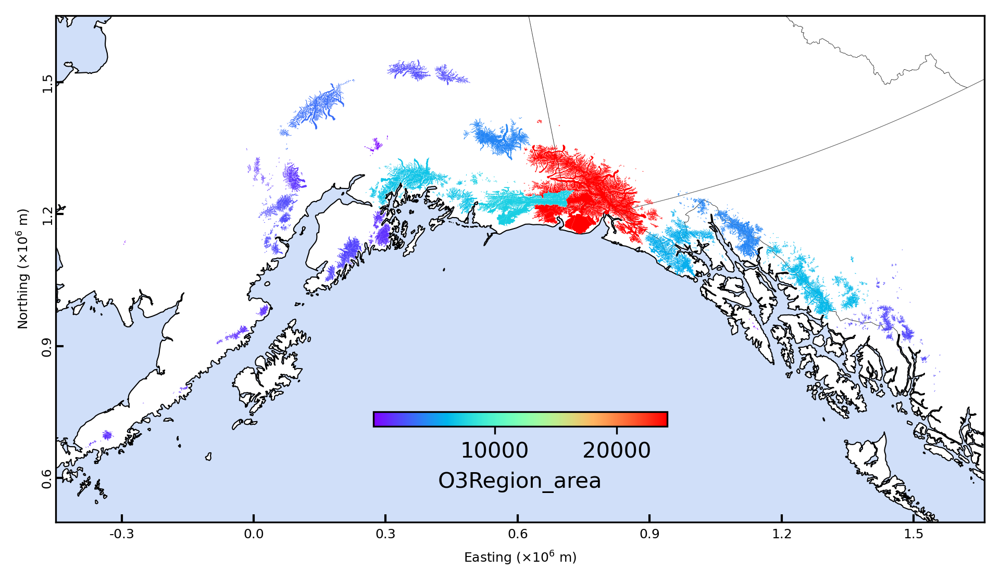

In [29]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='O3Region_area', zorder=10, cmap='rainbow', legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'O3Region_area'})

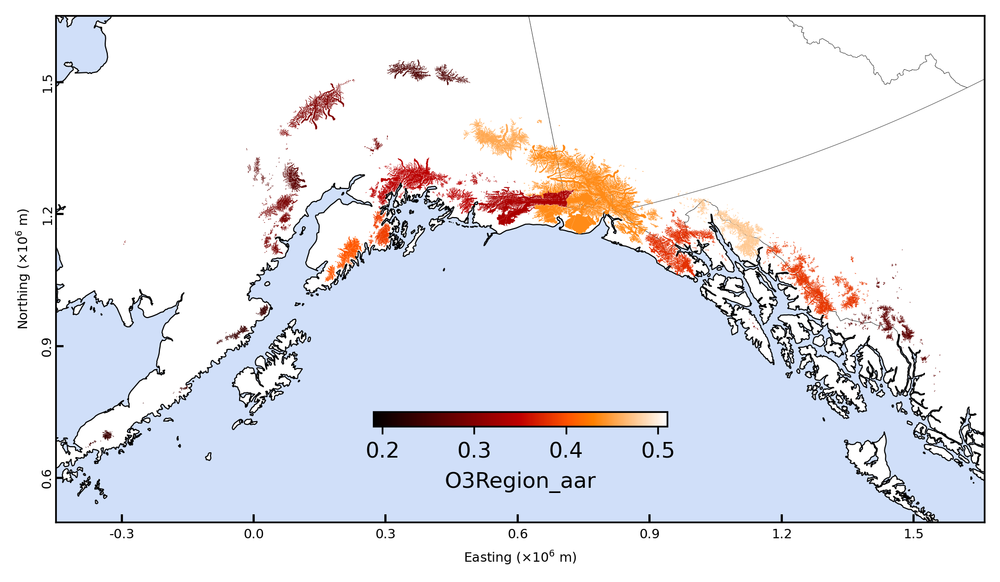

In [30]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='O3Region_aar', zorder=10, cmap='gist_heat', legend=True, vmin=0.19, vmax=0.51,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'O3Region_aar'})

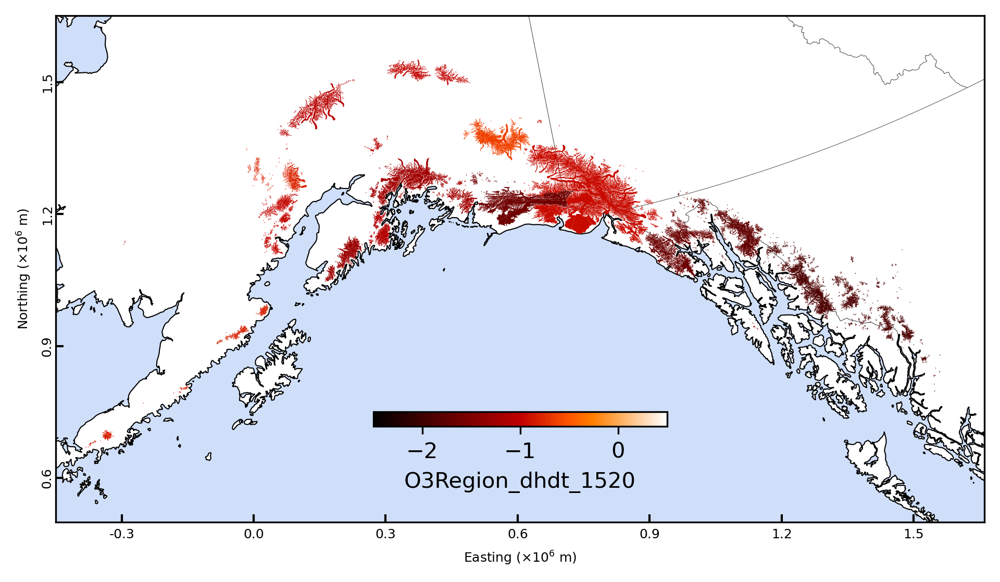

In [68]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='O3Region_dhdt_1520', zorder=10, cmap='gist_heat', vmin=-2.5, vmax=0.5, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'O3Region_dhdt_1520'})

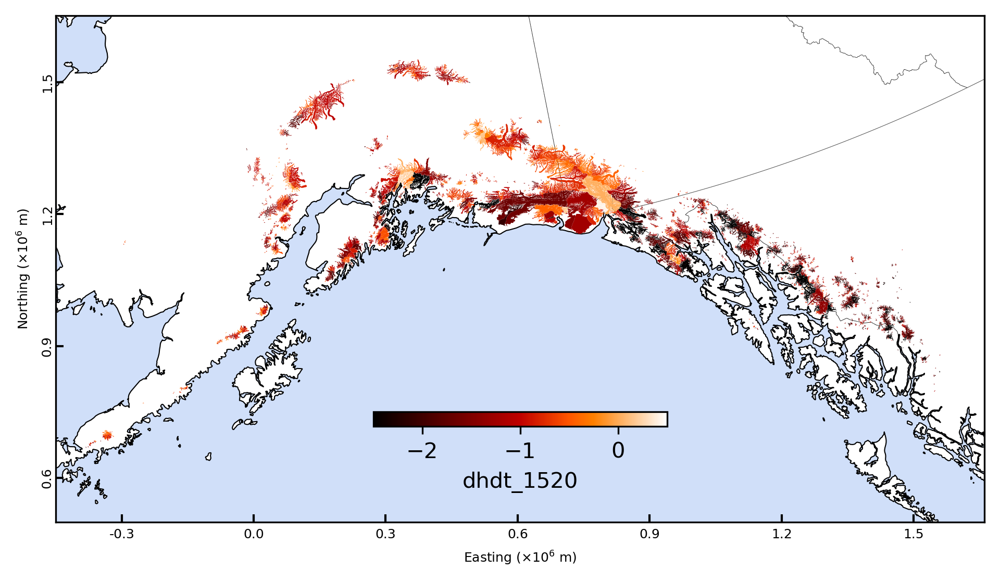

In [67]:
fig,axs = snowFun.create_base_map(hillshade=0)
geoms = all_data_gdf.plot(ax=axs, column='dhdt_1520', zorder=10, cmap='gist_heat', vmin=-2.5, vmax=0.5, legend=True,
                          legend_kwds={"location":'bottom', "fraction":0.02, 'pad':-0.15, "label":'dhdt_1520'})

### Now let's make some plots to investigate some of these relationships

In [ ]:
full_data_df['diff'] = full_data_df['ela']-full_data_df['Zmed']

x_col = 'CenLon'
y_col = 'CenLat'
color_col = 'diff'
c_log = 0
cmap = 'RdBu'

X = full_data_df[x_col]
Y = full_data_df[y_col]
colors = full_data_df[color_col].astype(float)
if c_log: colors = np.log(colors)

fig, axs = plt.subplots()
sc = axs.scatter(X,Y, c=colors, s=1, cmap=cmap)
axs.set_xlabel(x_col)
axs.set_ylabel(y_col)
plt.colorbar(sc, label=color_col)